# IGDB API Data for 200K + Games
## What makes a game good? Are there any trends/platform_description for successful games?
<img src='https://cdn-images-1.medium.com/max/1200/1*JwZ7l0LNnIVP9bPNjI8KZQ.jpeg'></img>
<figcaption style="text-align: center;">
    <strong>
        Photo by 
        <a href='https://pixabay.com/users/gam-ol-2829280/?utm_source=link-attribution&utm_medium=referral&utm_campaign=image&utm_content=3319946'>Oleg Gamulinskiy</a>
        on 
        <a href='https://pixabay.com/?utm_source=link-attribution&utm_medium=referral&utm_campaign=image&utm_content=3319946'>Pixabay</a>
    </strong>
</figcaption>

# 1. Introduction to the Dataset And The Aim of the EDA

IGDB.com is a video game database (acquired by Amazon-owned Twitch), intended for both game consumers and video game professionals alike. IGDB stands for Internet Game Database and consists of 2 primary parts, an online website consisting of a website and 3 mobile apps that provide game consumers with structured and up to date information about games and the gaming world.

This [dataset](https://www.kaggle.com/...link) of more than 200K games is collected from [IGDB API](https://api-docs.igdb.com/#about) using [igdb-api-v4 for python](https://github.com/twitchtv/igdb-api-python). This notebook tries to explore any common trends for games that have ratings from igdb and external critics.


In [1]:
# Base libraries
import time
import datetime
import os

# Scientific libraries
import numpy as np
import pandas as pd
from empiricaldist import Cdf, Pmf

# Visual libraries
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.cm import get_cmap
import seaborn as sns
import missingno as msno  # Visualize missing values

import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
# This ensures Plotly output works in multiple places:
# plotly_mimetype: VS Code notebook UI
# notebook: "Jupyter: Export to HTML" command in VS Code
# See https://plotly.com/python/renderers/#multiple-renderers
pio.renderers.default = "plotly_mimetype+notebook"


# Helper libraries
from tqdm.notebook import tqdm, trange
from colorama import Fore, Back, Style
import warnings
warnings.filterwarnings('ignore')

# Visual setup
import matplotlib.ticker as ticker
plt.style.use('ggplot')
rcParams['axes.spines.right'] = False
rcParams['axes.spines.top'] = False
rcParams['figure.figsize'] = [12, 9]
rcParams['font.size'] = 16
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)
custom_colors = ['#74a09e','#86c1b2','#98e2c6','#f3c969','#f2a553', '#d96548', '#c14953']
sns.set_palette(custom_colors)
%config InlineBackend.figure_format = 'retina'
%config Completer.use_jedi = False

# Pandas options
pd.set_option('max_colwidth', 40)
pd.options.display.max_columns = None  # Possible to limit
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

# Seed value for numpy.random
np.random.seed(42)

Load in the data:

In [310]:
#read data ignoring the index and id columns
df = pd.read_csv("data_200K.csv", usecols=lambda x: x not in ['Unnamed: 0', 'id'])
df.head()

,category,created_at,external_games,first_release_date,game_modes,genres,name,platforms,release_dates,screenshots,similar_games,slug,status,summary,tags,themes,updated_at,url,websites,age_ratings,involved_companies,parent_game,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks
0,0,1495739021,"[5526, 107828, 1927694]",1.459987e+09,[1],"[15, 32]",The Fifth Expedition,"[3, 6]","[77732, 77733]","[58357, 58358, 58359, 58360, 58361]","[25311, 25640, 34024, 36553, 37419, ...",the-fifth-expedition,4.0,Guide your team of explorers into th...,"[1, 268435471, 268435488]",[1],1643442946,https://www.igdb.com/games/the-fifth...,"[33480, 33481]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,1498435200,"[20127, 1988884]",5.364576e+08,NaN,[5],Dogou Souken,[52],[91007],NaN,"[12364, 27270, 43367, 103281, 103292...",dogou-souken,NaN,An overhead-view shoot'em up game.,[268435461],NaN,1604620800,https://www.igdb.com/games/dogou-souken,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,1517392813,"[216805, 1969751, 2005770]",1.404346e+09,NaN,[9],City Mysteries,[37],[138333],"[155025, 155026, 155027]","[10603, 19222, 25905, 41349, 86974, ...",city-mysteries,NaN,"Search buildings, streets, landmarks...",[268435465],NaN,1641425677,https://www.igdb.com/games/city-myst...,NaN,[37944],"[130531, 130532]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,1628007985,[2028338],NaN,NaN,NaN,Earth Defense Force: World Brothers ...,NaN,NaN,"[567675, 567676, 567677, 567678, 567...","[25636, 100800, 103298, 103301, 1033...",earth-defense-force-world-brothers-r...,NaN,"Riho Futaba (voiced by Yuko Goto), a...",[1],[1],1643475000,https://www.igdb.com/games/earth-def...,[208872],NaN,NaN,139067.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,1602368467,[1966278],1.525910e+09,[1],[32],sun machine,[82],[213594],"[403247, 403248]","[11666, 13200, 13660, 17130, 25311, ...",sun-machine,NaN,"a story of dark days, chronic fatigu...","[18, 268435488, 536896982]",[18],1639609570,https://www.igdb.com/games/sun-machine,[156114],NaN,[117090],NaN,[837],[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# 2. Basic Exploration and Data Cleaning

## 2.1 Basic Exploration

We will start with basic exploration of the dataset and see no. of non-null values and data types.

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201812 entries, 0 to 201811
Data columns (total 47 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   category                 201812 non-null  int64  
 1   created_at               201812 non-null  int64  
 2   external_games           192157 non-null  object 
 3   first_release_date       115916 non-null  float64
 4   game_modes               96545 non-null   object 
 5   genres                   156697 non-null  object 
 6   name                     201812 non-null  object 
 7   platforms                120738 non-null  object 
 8   release_dates            120466 non-null  object 
 9   screenshots              135835 non-null  object 
 10  similar_games            163187 non-null  object 
 11  slug                     201812 non-null  object 
 12  status                   12288 non-null   float64
 13  summary                  167394 non-null  object 
 14  tags

There are 47 columns, 201812 rows and several of them have missing values.

In [383]:
# Count how many times each data type is present in the dataset
pd.value_counts(df.dtypes)

object     31
float64    13
int64       3
dtype: int64

We have 31 object type column and 16 numeric columns

In [22]:
# Display non-numerical features
df.select_dtypes(exclude="number").head()

,genres,name,platforms,release_dates,similar_games,slug,summary,themes,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,storyline,version_title,franchises,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,category_description
0,"[15, 32]",The Fifth Expedition,"[3, 6]","[77732, 77733]","[25311, 25640, 34024, 36553, 37419, ...",the-fifth-expedition,Guide your team of explorers into th...,[1],"[33480, 33481]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
1,[5],Dogou Souken,[52],[91007],"[12364, 27270, 43367, 103281, 103292...",dogou-souken,An overhead-view shoot'em up game.,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
2,[9],City Mysteries,[37],[138333],"[10603, 19222, 25905, 41349, 86974, ...",city-mysteries,"Search buildings, streets, landmarks...",NaN,NaN,[37944],"[130531, 130532]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
3,[32],sun machine,[82],[213594],"[11666, 13200, 13660, 17130, 25311, ...",sun-machine,"a story of dark days, chronic fatigu...",[18],[156114],NaN,[117090],[837],[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
4,NaN,Transformers Prime: The Game,NaN,NaN,NaN,transformers-prime-the-game,NaN,NaN,NaN,[67799],[85230],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game


In [23]:
# Display numerical features
df.select_dtypes(include="number").head()

,category,created_at,first_release_date,status,updated_at,rating,rating_count,total_rating,total_rating_count,version_parent,hypes,follows,franchise,aggregated_rating,aggregated_rating_count
0,0,1495739021,1.459987e+09,4.0,1643442946,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,1498435200,5.364576e+08,NaN,1604620800,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,1517392813,1.404346e+09,NaN,1641425677,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0,1602368467,1.525910e+09,NaN,1639609570,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,1517405808,NaN,NaN,1651604097,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Let's explore the missing values now.

In [8]:
df.isnull().sum()

category                        0
created_at                      0
external_games               9655
first_release_date          85896
game_modes                 105267
genres                      45115
name                            0
platforms                   81074
release_dates               81346
screenshots                 65977
similar_games               38625
slug                            0
status                     189524
summary                     34418
tags                        38598
themes                      98690
updated_at                      0
url                             0
websites                    73589
age_ratings                158039
involved_companies         118302
parent_game                182153
game_engines               185789
player_perspectives        141230
videos                     159580
rating                     173405
rating_count               173405
storyline                  185530
total_rating               168538
total_rating_c

Many columns have large portion of missing values. 
Not all these columns will be useful for us as the dataset appears to be sparse. Let's exclude unnecessary columns later.

Next, looking at the dataset info again:

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201812 entries, 0 to 201811
Data columns (total 47 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   category                 201812 non-null  int64  
 1   created_at               201812 non-null  int64  
 2   external_games           192157 non-null  object 
 3   first_release_date       115916 non-null  float64
 4   game_modes               96545 non-null   object 
 5   genres                   156697 non-null  object 
 6   name                     201812 non-null  object 
 7   platforms                120738 non-null  object 
 8   release_dates            120466 non-null  object 
 9   screenshots              135835 non-null  object 
 10  similar_games            163187 non-null  object 
 11  slug                     201812 non-null  object 
 12  status                   12288 non-null   float64
 13  summary                  167394 non-null  object 
 14  tags

Some columns have incorrect data types: created_at, first_release_date. created_at and first_release_date seem to be unix timestamp and need to be converted to datetime.


Now, let's look at the game categories. These indicate if the game is a main game, dlc add-on, expansion, mod, etc.
But category only has values and not interpretable. So, let's get the mapping and join the category descriptions which are readable.

In [312]:
# Read category mapping
category_mapping = pd.read_csv("category_mapping.csv")

# Merge category descriptions
df = pd.merge(df, category_mapping, on=["category"])
df.head()


,category,created_at,external_games,first_release_date,game_modes,genres,name,platforms,release_dates,screenshots,similar_games,slug,status,summary,tags,themes,updated_at,url,websites,age_ratings,involved_companies,parent_game,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,category_description
0,0,2017-05-25 19:03:41,"[5526, 107828, 1927694]",2016-04-07,[1],"[15, 32]",The Fifth Expedition,"[3, 6]","[77732, 77733]","[58357, 58358, 58359, 58360, 58361]","[25311, 25640, 34024, 36553, 37419, ...",the-fifth-expedition,4.0,Guide your team of explorers into th...,"[1, 268435471, 268435488]",[1],2022-01-29 07:55:46,https://www.igdb.com/games/the-fifth...,"[33480, 33481]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
1,0,2017-06-26 00:00:00,"[20127, 1988884]",1987-01-01,NaN,[5],Dogou Souken,[52],[91007],NaN,"[12364, 27270, 43367, 103281, 103292...",dogou-souken,NaN,An overhead-view shoot'em up game.,[268435461],NaN,2020-11-06 00:00:00,https://www.igdb.com/games/dogou-souken,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
2,0,2018-01-31 10:00:13,"[216805, 1969751, 2005770]",2014-07-03,NaN,[9],City Mysteries,[37],[138333],"[155025, 155026, 155027]","[10603, 19222, 25905, 41349, 86974, ...",city-mysteries,NaN,"Search buildings, streets, landmarks...",[268435465],NaN,2022-01-05 23:34:37,https://www.igdb.com/games/city-myst...,NaN,[37944],"[130531, 130532]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
3,0,2020-10-10 22:21:07,[1966278],2018-05-10,[1],[32],sun machine,[82],[213594],"[403247, 403248]","[11666, 13200, 13660, 17130, 25311, ...",sun-machine,NaN,"a story of dark days, chronic fatigu...","[18, 268435488, 536896982]",[18],2021-12-15 23:06:10,https://www.igdb.com/games/sun-machine,[156114],NaN,[117090],NaN,[837],[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
4,0,2018-01-31 13:36:48,"[221231, 1748471, 1991656]",NaT,NaN,NaN,Transformers Prime: The Game,NaN,NaN,NaN,NaN,transformers-prime-the-game,NaN,NaN,NaN,NaN,2022-05-03 18:54:57,https://www.igdb.com/games/transform...,NaN,[67799],[85230],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game


In [12]:
df['category_description'].value_counts()

main_game               179613
dlc_addon                11185
port                      2728
bundle                    2546
mod                       1549
expansion                 1104
expanded_game              871
remake                     618
remaster                   585
episode                    462
standalone_expansion       255
season                     251
fork                        45
Name: category_description, dtype: int64

Looks like a vast majority of the games in this dataset are main games and the rest are dlcs, ports, bundles, expansions.

Now, let's explore the numerical features of the dataset and see if they contain any issues:

In [6]:
# Display in normal notation instead of scientific
with pd.option_context('float_format', '{:f}'.format):
    df.describe()

,category,created_at,first_release_date,status,updated_at,parent_game,rating,rating_count,total_rating,total_rating_count,version_parent,hypes,follows,franchise,aggregated_rating,aggregated_rating_count
count,201812.000000,201812.000000,115916.000000,12288.000000,201812.000000,19659.000000,28407.000000,28407.000000,33274.000000,33274.000000,5057.000000,8520.000000,21268.000000,1522.000000,14197.000000,14197.000000
mean,0.415198,1552772717.998132,1310630812.436592,3.951497,1633893407.702570,60131.704410,66.549716,20.232020,66.354925,18.844714,62754.630809,3.893545,11.354711,132.422470,68.875231,3.684440
std,1.704122,73971292.947405,339450765.067517,1.116590,25232072.207712,61167.169800,14.426715,99.293201,14.726604,93.382958,59818.832293,18.574610,47.328321,122.131167,16.147509,4.124116
min,0.000000,1297556438.000000,-694396800.000000,0.000000,1432684800.000000,1.000000,10.001966,0.000000,0.000000,0.000000,4.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,0.000000,1501632000.000000,1130976000.000000,4.000000,1616353472.000000,6494.000000,59.376556,0.000000,58.751052,0.000000,9191.000000,1.000000,1.000000,26.000000,60.000000,1.000000
50%,0.000000,1535932800.000000,1456704000.000000,4.000000,1643460369.500000,33463.000000,70.000000,1.000000,70.000000,1.000000,33740.000000,1.000000,2.000000,93.500000,71.000000,2.000000
75%,0.000000,1627934612.500000,1560470400.000000,4.000000,1651746074.500000,116330.000000,78.122080,8.000000,77.500000,8.000000,119304.000000,2.000000,5.000000,222.000000,80.000000,4.000000
max,12.000000,1661597514.000000,1923955200.000000,8.000000,1661619245.000000,214619.000000,100.000000,3541.000000,100.000000,3578.000000,214675.000000,1038.000000,1779.000000,444.000000,100.000000,59.000000


Rating related columns seem to have values ranging from 0 to 100 as expected and do not have any outliers. Average rating seems to be 66 for all games across all platforms but median is more reliable because rating might be skewed. total_rating seems to be the most populated one compared to rating and aggregated_rating but it is still missing for many games. We will explore a bit more and decide if we should focus on total_rating (most interesting variable) for our analysis.

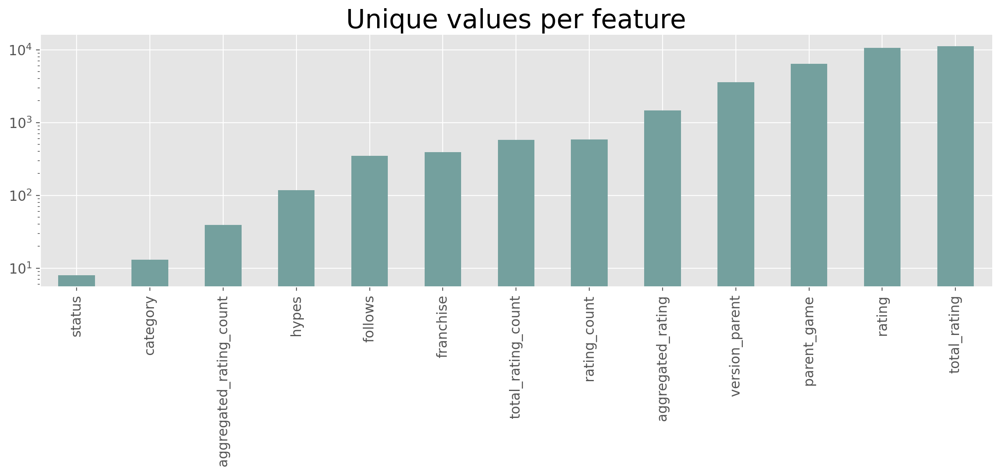

In [14]:
# For each numerical feature compute number of unique entries
unique_values = df.select_dtypes(include="number").nunique().sort_values()

# Plot information with y-axis in log-scale
unique_values.plot.bar(logy=True, figsize=(15, 4), title="Unique values per feature");

Let's explore the non-numerical features of the dataset

In [59]:
df.describe(exclude="number")


,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,storyline,version_title,franchises,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,category_description
count,201812,115916,156697,201812,120738,120466,163187,201812,167394,103122,201812,128223,43773,83510,16023,60582,42232,16282,4864,15827,8976,2165,2058,566,541,822,564,203,34,201812
unique,155802,11212,2733,195544,5033,120466,62566,201809,164278,1684,124111,128223,43773,83510,1142,76,42232,15578,1520,3217,8976,2165,2058,566,541,822,564,203,34,13
top,2017-09-28 00:00:00,2022-12-31 00:00:00,[32],Pac-Man,[6],"[77732, 77733]","[65827, 75948, 94741, 106992, 111043...",3,"Pixel Puzzles Ultimate, redefining d...",[1],2020-08-26 00:00:00,"[33480, 33481]",[37944],"[130531, 130532]",[13],[3],[30914],Donkey Kong has kidnapped the beauti...,Collector's Edition,[845],[8942],[167245],[80851],[211899],[2381],"[15719, 28980]",[42601],[79369],[138233],main_game
freq,1211,824,14902,28,40199,1,5035,2,128,45171,20008,1,1,1,3763,13901,1,22,812,222,1,1,1,1,1,1,1,1,1,179613
first,2011-02-13 00:20:38,1947-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-05-27 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2022-08-27 10:51:54,2030-12-20 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-08-27 16:54:05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


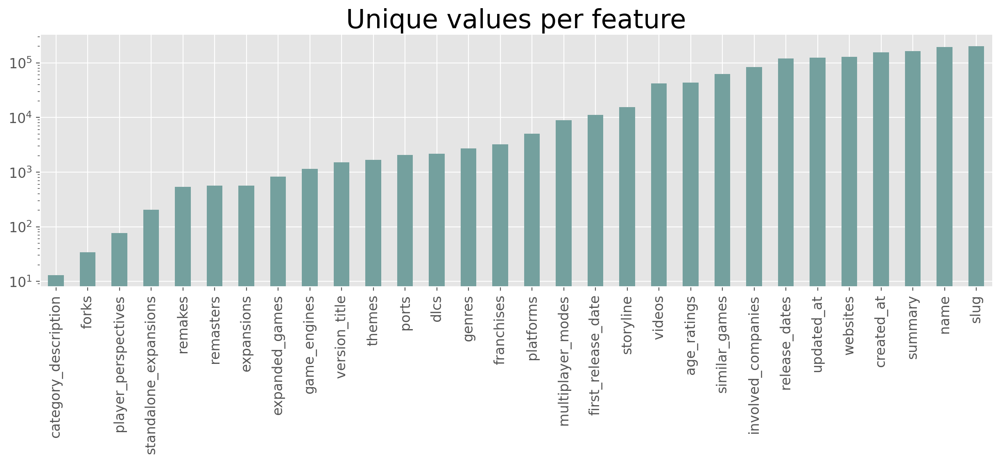

In [60]:
# For each numerical feature compute number of unique entries
unique_values = df.select_dtypes(exclude="number").nunique().sort_values()

# Plot information with y-axis in log-scale
unique_values.plot.bar(logy=True, figsize=(15, 4), title="Unique values per feature");

Before we further explore, let's deal with the issues we highlighted. Here is the final list:

### Issues List For the Dataset
- Drop unnecessary columns or columns that do not provide useful information to answer our questions.
- Missing values in several columns. Some columns may not even be useful as they are sparsely populated.
- Incorrect data types for some columns.
- Many columns have ids in a list that need their descriptions to be mapped from other datasets.
- Drop unnecessary categories or unpack values in columns as most of them seem to have 1000s of category combinations. For example, platform column has ['action', 'adventure', 'shooting'] for each game. This would not be useful if we want to analyze how each variable is related to total_rating unless we unpack or simplify each observation.

## 2.2 Data Cleaning

It is a good practice to start cleaning from the easiest issues. We can drop external_games (external ids that a game has on other platform_descriptions/services), parent_game (if the game is a parent or a spin off), screenshots, tags and urls.
game_modes has information on whether a game is a single player, multi player etc but it has a lot of missing data. More over, we can get this single player vs multi player flags from other column which comes later in the notebook. So, it can be excluded here.


### Drop unnecessary columns

In [314]:
# Specify the cols to drop
to_drop = [
    'external_games',
    'parent_game', 'screenshots', 'tags', 'url', 'game_modes'
]

# Drop them
df.drop(to_drop, axis='columns', inplace=True)


### Convert to Correct Data Types

In [ ]:
df['first_release_date'] = pd.to_datetime(df['first_release_date'],unit='s')
df['created_at'] = pd.to_datetime(df['created_at'],unit='s')
df['updated_at'] = pd.to_datetime(df['updated_at'],unit='s')
df.tail()
df.first_release_date.unique()

### Deal With Missing Values

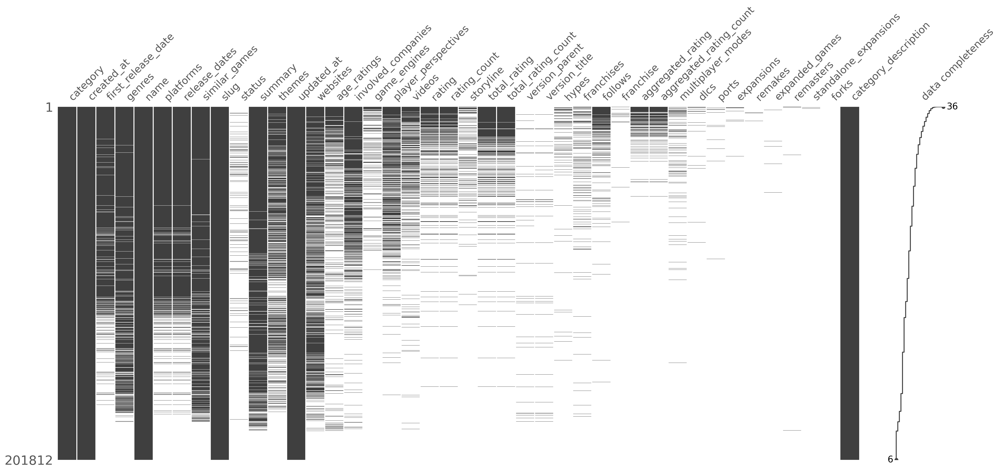

In [8]:
msno.matrix(df, labels=True, sort="descending");

This dataset seems to become increasingly sparse as we go from top left to bottom right! Much of the data is missing.

This is one of the challenges with the data collection. We do not know how complete the data is until we have finished collecting all the data through api. In this case, the api had a limit of 500 rows per request and so we had to do multiple requests in a loop. It's turning out to be an underwhelming dataset!

let's now look at the number of missing values per feature

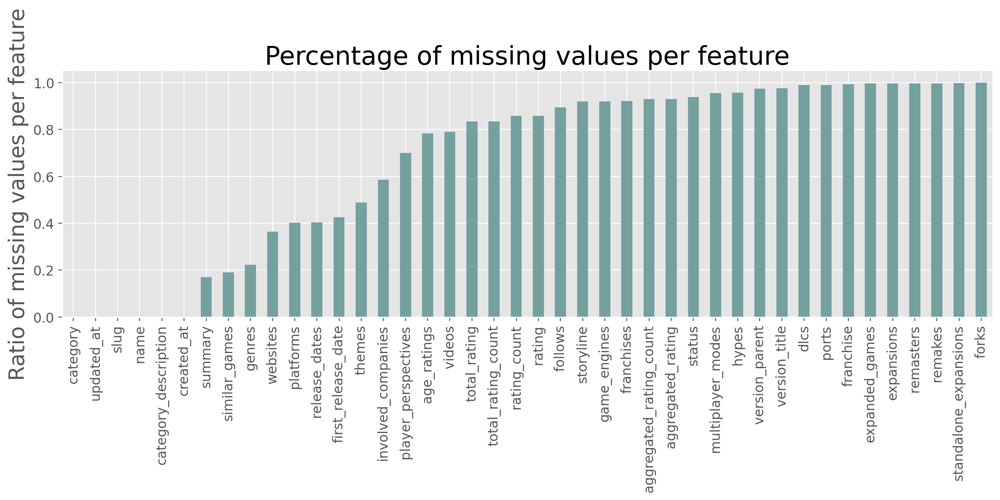

In [9]:
df.isna().mean().sort_values().plot(
    kind="bar", figsize=(15, 4),
    title="Percentage of missing values per feature",
    ylabel="Ratio of missing values per feature");

Most of the features in the dataset have more than 50% of missing values which is underwhelming. Many of these would have to be dropped depending the goals if we want to build models. For example, if we want to drop any feature that has more than 20% of missingness, we can use df.dropna(thresh=df.shape[0] * 0.85, axis=1).

But for now, let's just focus on the exploratory data analysis.
Out of all rating related columns, although they all have more than 80% of missingness, total_rating seems to have least missing values.

Let's plot the missingness correlation:

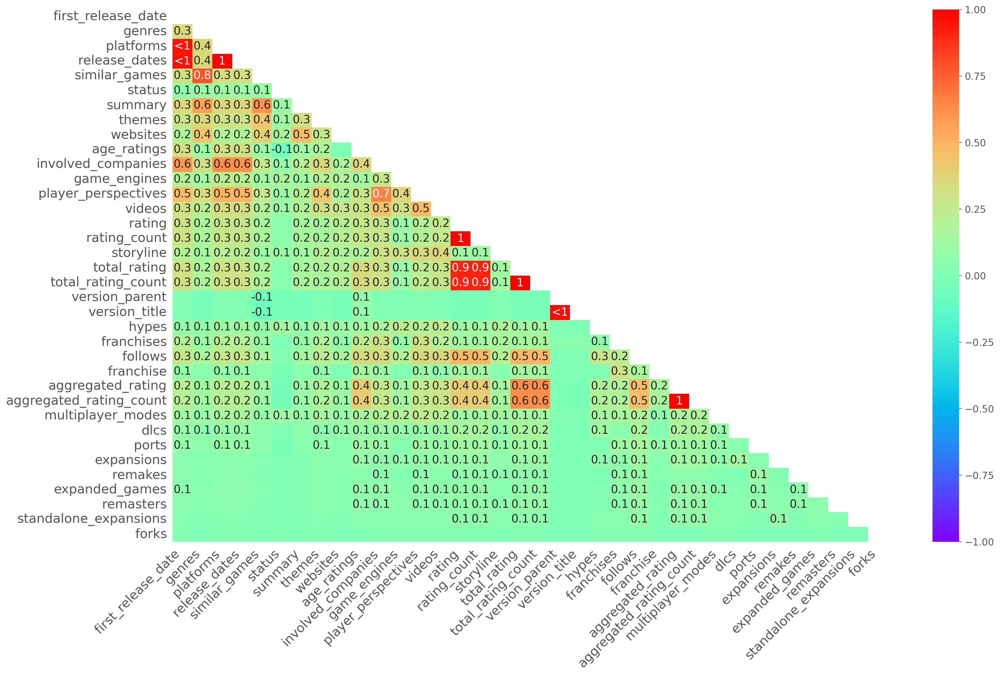

In [13]:
msno.heatmap(df, cmap='rainbow');

The correlation matrix of missingness shows that:

- release_dates and first_release_date are populated (or missing) whenever platform_descriptions is populated (or missing)
- all rating_count and rating related columns are highly correlated for missingness as expected
- similar_games is populated if genre is populated in most cases
- player_perspectives is populated when involved_companies is populated in most cases


We are most interested in total_rating as we are assuming this indicates the success of a game. It has less missingness compared to other rating features and it is also the average rating based on both IGDB user and external critic scores. It's missingness seems to be random and does not depend on any particular variable other than total_rating_count, rating and rating_count which is expected.

Let's plot correlation matrix and see any weak, medium or strong correlations between numerical features.

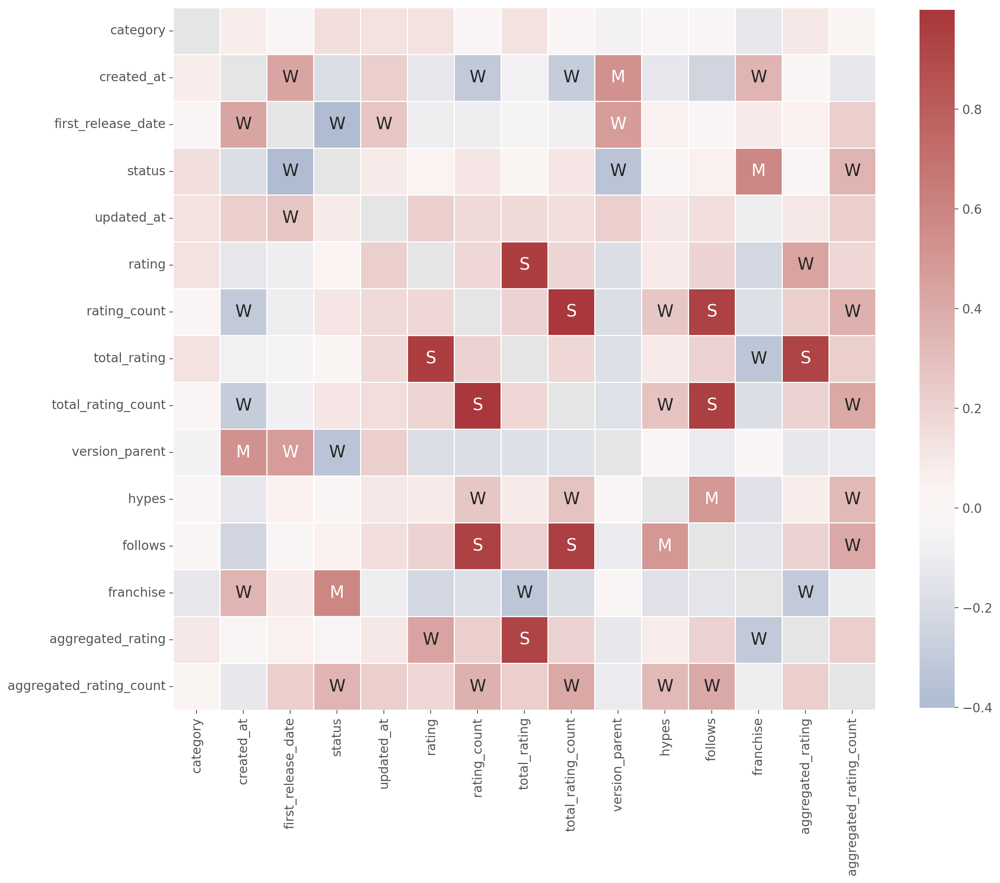

In [14]:
# Computes feature correlation
df_corr = df.corr(method="pearson")

# Create labels for the correlation matrix
labels = np.where(np.abs(df_corr)>0.75, "S",
                  np.where(np.abs(df_corr)>0.5, "M",
                           np.where(np.abs(df_corr)>0.25, "W", "")))

# Plot correlation matrix
plt.figure(figsize=(15, 15))
sns.heatmap(df_corr, mask=np.eye(len(df_corr)), square=True,
            center=0, annot=labels, fmt='', linewidths=.5,
            cmap="vlag", cbar_kws={"shrink": 0.8});

total_rating_count has a strong positive correlation with number of follows.
number of hypes has weak positive correlation with number of ratings and a medium positive correlation with the number of follows.
franchise is just a numeric code and it's relations are not useful here.

Let us drop all rows that have a missing total_rating as these are not useful for our analysis.

In [315]:
df_ratings = df.dropna(subset = ['total_rating'], axis = 0)
df_ratings.shape
df_ratings.head()

(33274, 42)

,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,category_description
14,0,2016-03-08 17:38:57,2010-04-20,[7],Beat City,[20],"[47952, 47953]","[11711, 18981, 54774, 63933, 67774, ...",beat-city,NaN,A rhythm-based mini-game collection ...,[1],2022-05-11 20:44:24,NaN,"[8122, 8123]","[164713, 164714]",NaN,[4],NaN,60.00000,0.0,"Can you feel the beat? Life, color, ...",60.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
22,0,2018-05-07 00:00:00,NaT,"[14, 33]",Flying Arrow!.,NaN,NaN,"[14733, 87053, 90965, 109606, 116349...",flying-arrow--1,NaN,Flying Arrow is a game control throw...,NaN,2020-11-06 00:00:00,[78501],[21881],NaN,NaN,NaN,NaN,34.16185,0.0,NaN,34.16185,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
53,0,2019-03-17 15:12:50,2020-02-20,[32],Monster Jaunt,"[6, 14]","[187859, 189529]","[65827, 75948, 94741, 106992, 111043...",monster-jaunt,NaN,A throwback minigame party that won'...,NaN,2021-10-18 19:42:58,"[103282, 103283, 235726, 235728, 235...",NaN,[92093],NaN,NaN,[33557],70.00000,0.0,NaN,70.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
55,0,2016-09-22 18:55:27,NaT,NaN,Memorick: The Apprentice Knight,NaN,NaN,NaN,memorick-the-apprentice-knight,NaN,NaN,NaN,2022-04-14 20:16:08,NaN,[65727],NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.00000,1.0,NaN,NaN,NaN,NaN,NaN,NaN,69.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game
98,0,2017-11-30 04:57:51,2017-11-30,"[5, 8, 32]",Cobalt WASD,[6],[130083],"[32902, 43367, 55042, 76263, 102868,...",cobalt-wasd,NaN,Cobalt WASD is a multiplayer bomb-de...,[1],2022-01-29 16:49:37,"[65664, 65665, 126839]",NaN,"[58669, 58670]",NaN,[4],[16956],60.00000,0.0,NaN,60.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game


A little disappointing that the size of our dataset drastically reduced (from 201812 rows to 33274 rows) after dropping rows with missing total_rating!

Let's get a global view of our data and see if we can get any ideas for cleaning or analysis.

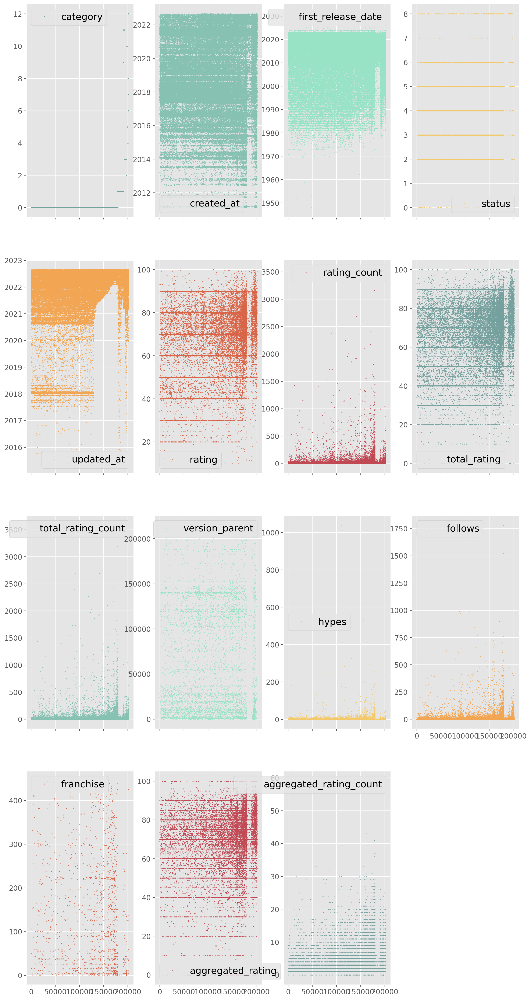

In [393]:
df.plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
          figsize=(15, 30), markersize=1);

The y-axis shows the feature value, while the x-axis is the sample index (row) from our dataset.

Category seems to be mostly 0 which indicates that a vast majority of the games belong to 'main game' category. For documentation, please visit https://api-docs.igdb.com/#game
Most frequently occuring value in status is 4 which is a code for early_access. I expected this to be 1 (code for games released) but seems like the code won't change from 4 to 1.As it stands, this feature is not so clear on how to interpret it.
Hypes, follows and rating_count seem to exhibit very similar patterns and its either there's more followers or more emphasis on data collection (may be they made it more accessible to follow a game?) for these in the last few years.
Most of this data seems to have been populated between 2016-2018. First release date and updated at columns have more density in recent years indicating that this dataset might have more features populated for 'new' games. Rating features have clear dense points at 50, 60, 70... confirming that people usually rate in tens units which is common in these kinds of datasets.

# 3. Univariate Exploration

We will look at the distribution of the numerical features of the dataset. 

Let's start with rating:

In [395]:



fig = px.histogram(df_ratings, x="total_rating", nbins = 55, title = "A Histogram of Game Ratings")
fig.show()

Histogram shows that majority of the games are rated between 50 and 80 with majority at 70.

Let's plot a histogram for all numerical features.

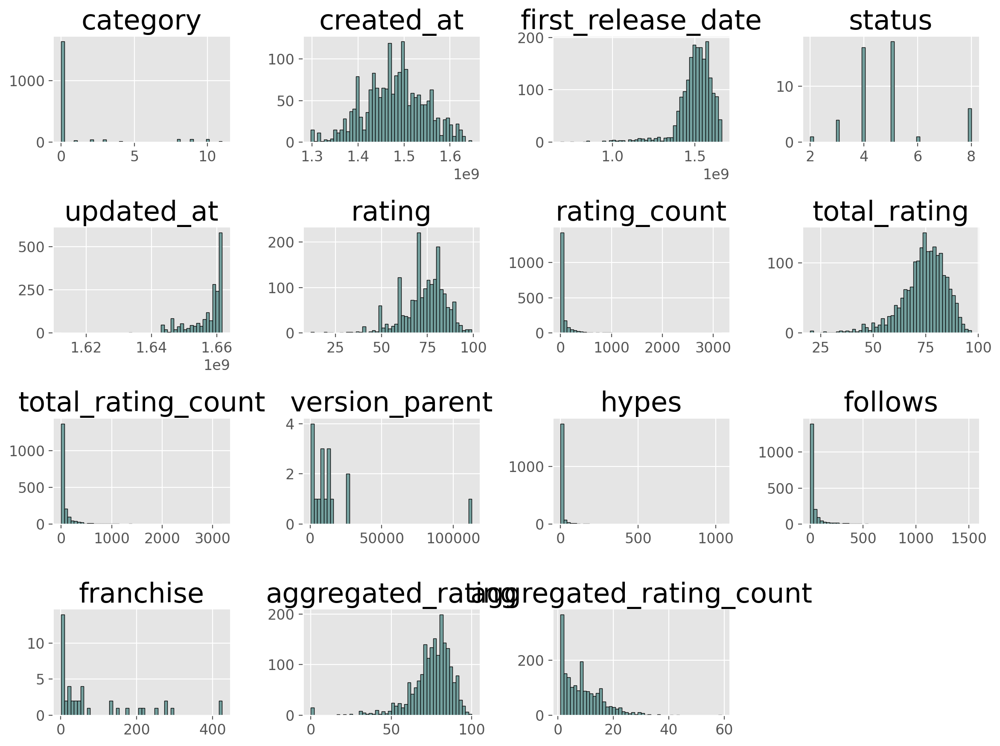

In [19]:
# Get rid off zeroes as they overshadow other values
df_ratings_for_hist = df_ratings.query('rating_count > 0 & total_rating_count > 0 & hypes > 0 & follows > 0 & aggregated_rating_count > 0')
#df_ratings_for_hist.describe()
# Plots the histogram for each numerical feature in a separate subplot
df_ratings_for_hist.hist(bins=50, edgecolor="black") #figsize=(15, 25), layout=(-1, 5)
plt.tight_layout();

Getting rid off zeroes in total_rating_count and other rating count columns eliminates the spikes we see at 50, 60, 70 and 80 ratings which means that for most of the games, even though their total_rating_count/rating_count/aggregated_rating_count is zero, the rating column was filled with scores in tens units (50, 60, 70,...).
Most of the ratings seem to have come from just one source based on total_rating_count, aggregated_rating_count, and rating_count.

Let's do a pair plot to focus on interesting columns!

category                   False
status                     False
rating                     False
rating_count               False
total_rating                True
total_rating_count          True
version_parent             False
hypes                       True
follows                     True
franchise                  False
aggregated_rating          False
aggregated_rating_count    False
log_hypes                   True
log_follows                 True
log_total_rating_count      True
dtype: bool

Text(0.5, 2386.924603174603, '')

Text(71.22189484126983, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'log_follows')

Text(876.063209974353, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'log_hypes')

Text(1260.1158119853387, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'follows')

Text(2028.2210160073107, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'hypes')

Text(2412.2736180182965, 0.5, 'total_rating')

Text(0.5, 2003.2658730158732, 'total_rating')

Text(76.59689484126983, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, '')

Text(492.0106079633669, 0.5, '')

Text(0.5, 2003.2658730158732, 'log_follows')

Text(876.063209974353, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'log_hypes')

Text(1260.1158119853387, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'follows')

Text(2028.2210160073107, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'hypes')

Text(2412.2736180182965, 0.5, 'log_total_rating_count')

Text(0.5, 1619.6071428571431, 'total_rating')

Text(76.59689484126983, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, '')

Text(876.063209974353, 0.5, '')

Text(0.5, 1619.6071428571431, 'log_hypes')

Text(1260.1158119853387, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'follows')

Text(2028.2210160073107, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'hypes')

Text(2412.2736180182965, 0.5, 'log_follows')

Text(0.5, 1235.948412698413, 'total_rating')

Text(76.59689484126983, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'log_follows')

Text(876.063209974353, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, '')

Text(1260.1158119853387, 0.5, '')

Text(0.5, 1235.948412698413, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'follows')

Text(2028.2210160073107, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'hypes')

Text(2412.2736180182965, 0.5, 'log_hypes')

Text(0.5, 852.2896825396828, 'total_rating')

Text(60.59689484126983, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'log_follows')

Text(876.063209974353, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'log_hypes')

Text(1260.1158119853387, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, '')

Text(1644.1684139963247, 0.5, '')

Text(0.5, 852.2896825396828, 'follows')

Text(2028.2210160073107, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'hypes')

Text(2412.2736180182965, 0.5, 'total_rating_count')

Text(0.5, 468.63095238095235, 'total_rating')

Text(60.59689484126983, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'log_follows')

Text(876.063209974353, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'log_hypes')

Text(1260.1158119853387, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'follows')

Text(0.5, 468.63095238095235, '')

Text(2028.2210160073107, 0.5, '')

Text(0.5, 468.63095238095235, 'hypes')

Text(2412.2736180182965, 0.5, 'follows')

Text(0.5, 65.11111111111083, 'total_rating')

Text(60.59689484126983, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'log_follows')

Text(876.063209974353, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'log_hypes')

Text(1260.1158119853387, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'follows')

Text(2028.2210160073107, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'hypes')

Text(2412.2736180182965, 0.5, '')

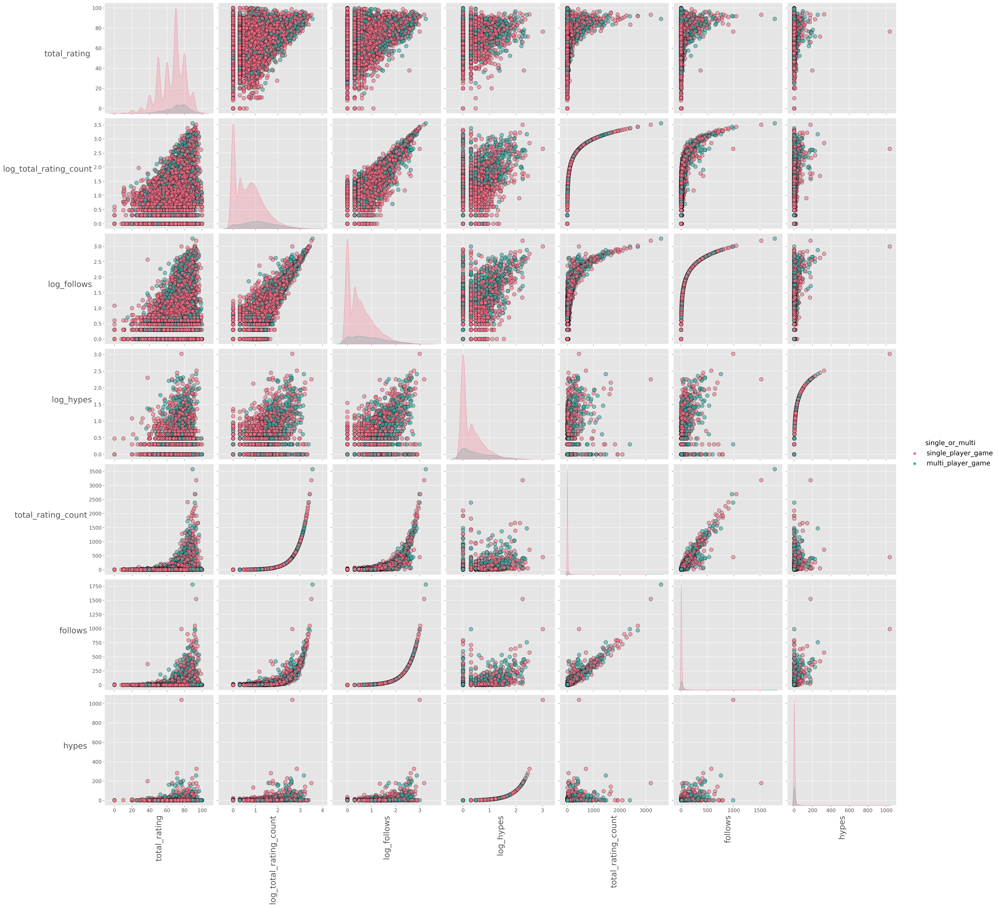

In [316]:
#adding a flag to indicate whether the game is a multiplayer or not
df_ratings['single_or_multi'] = np.where(df_ratings['multiplayer_modes'].isna(), 'single_player_game', 'multi_player_game')

# Take the log of hypes, follows and total_rating_count as they are extremely right skewed
df_ratings['log_hypes'] = np.log10(df_ratings['hypes'])
df_ratings['log_follows'] = np.log10(df_ratings['follows'])
df_ratings['log_total_rating_count'] = np.log10(df_ratings['total_rating_count'])

""" # Creates mask to identify numerical features with more or less than 25 unique features
cols_continuous = df_ratings.select_dtypes(include="number").nunique() >= 25

# Remove rating, rating_count, aggregated_rating and aggregated_rating_count columns as we already know they are related. Also, franchise and version_parent are just codes and not continuous.
# Removing all these columns will de-clutter the plot a bit.
cols_continuous[2:4] = False
cols_continuous[6] = False
cols_continuous[9:12] = False
cols_continuous
# Create a new dataframe which only contains the continuous features we need
df_continuous = df_ratings[cols_continuous[cols_continuous].index] """

g = sns.pairplot(df_ratings, vars = ['total_rating','log_total_rating_count','log_follows','log_hypes','total_rating_count', 'follows', 'hypes'],
                 dropna = True, diag_kind = 'kde', size = 4, hue = 'single_or_multi', palette='husl',
                 plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'}
                 ) #plot_kws={"s": 2, "alpha": 0.2}); # plot_kws = {'line_kws':{'alpha': 0.2, 's':80, 'color':'red'}}
# Rotate xtick labels
for ax in g.axes.flatten():
    # rotate x axis labels
    ax.set_xlabel(ax.get_xlabel(), rotation = 90)
    # rotate y axis labels
    ax.set_ylabel(ax.get_ylabel(), rotation = 0)
    # set y labels alignment
    ax.yaxis.get_label().set_horizontalalignment('right')

Based on this, games may have higher ratings if more people have rated them (total_rating_count).
It is hard to say from this but Hype around the game or number of follows don't seem to have a strong relationship with higher rating which is surprising.
Hypes = no of follows to a game before release
Follows = no of follows to a game after release
Hypes and Follows have a positive correlation as expected. We can observe that in some cases, games with less hypes (follows before release) may have more no. of follows (after release) but games with less follows do not have as many hypes relatively.
Similarly, as more people follow a game, the more they tend to rate it (count).

Now, let's look at what's the proportion of gaming platforms in this dataset. We need to join platform names first as platform column just has ids and no names. But each value in platform_descriptions column may contain a list of multiple values (if the game released in multiple platforms). So, we need to map descriptions for them.

Similarly, we need to map descriptions for genres, themes, age groups, and player perspectives.
So let's create a mapping function first.


In [317]:
def map_desc_inside_list(df, col_to_map, desc_file, desc_col_name):
    
    
    
    #first, we need to fill NaNs with empty lists for map to work
    #filling NaNs with lists for platform_descriptions column
    #converting empty lists to strings to make it consistent with the rest of the values. Existing list of values in each observation are being considered already as strings (not lists).
    df[col_to_map] = df[col_to_map].fillna({i: [0] for i in df.index}).astype(str)


    df[col_to_map] = df[col_to_map].apply(lambda x: [int(el) for el in x.strip("[]").split(",")])

    desc_mapping = pd.read_csv(desc_file)

    #creating a dict of platform_description ids and descriptions
    if('name' in desc_mapping.columns):
        desc_dict = desc_mapping.groupby('id')['name'].agg(pd.Series).to_dict()
    else:
        desc_dict = desc_mapping.groupby('id')['age_group'].agg(pd.Series).to_dict()

    """ temp_dict = {}

    for k,v in platform_description_dict.items():
    #k = str(k)
    temp_dict[k] = v[0] """


    df[desc_col_name] = df[col_to_map].apply(lambda x:list(filter(None,map(desc_dict.get,x))))

    return df

In [318]:
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'platforms', desc_file = "platforms.csv", desc_col_name = 'platform_description')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'genres', desc_file = "genres.csv", desc_col_name = 'genres_description')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'themes', desc_file = "themes.csv", desc_col_name = 'themes_description')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'age_ratings', desc_file = "age_ratings.csv", desc_col_name = 'age_group')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'player_perspectives', desc_file = "player_perspectives.csv", desc_col_name = 'player_perspectives_description')
df_ratings.head()

,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,category_description,single_or_multi,log_hypes,log_follows,log_total_rating_count,platform_description,genres_description,themes_description,age_group,player_perspectives_description
14,0,2016-03-08 17:38:57,2010-04-20,[7],Beat City,[20],"[47952, 47953]","[11711, 18981, 54774, 63933, 67774, ...",beat-city,NaN,A rhythm-based mini-game collection ...,[1],2022-05-11 20:44:24,NaN,"[8122, 8123]","[164713, 164714]",NaN,[4],NaN,60.00000,0.0,"Can you feel the beat? Life, color, ...",60.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,single_player_game,NaN,NaN,-inf,[Nintendo DS],[Music],[Action],"[0+, 7+]",[Side view]
22,0,2018-05-07 00:00:00,NaT,"[14, 33]",Flying Arrow!.,[0],NaN,"[14733, 87053, 90965, 109606, 116349...",flying-arrow--1,NaN,Flying Arrow is a game control throw...,[0],2020-11-06 00:00:00,[78501],[21881],NaN,NaN,[0],NaN,34.16185,0.0,NaN,34.16185,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,single_player_game,NaN,NaN,-inf,[],"[Sport, Arcade]",[],[0+],[]
53,0,2019-03-17 15:12:50,2020-02-20,[32],Monster Jaunt,"[6, 14]","[187859, 189529]","[65827, 75948, 94741, 106992, 111043...",monster-jaunt,NaN,A throwback minigame party that won'...,[0],2021-10-18 19:42:58,"[103282, 103283, 235726, 235728, 235...",[0],[92093],NaN,[0],[33557],70.00000,0.0,NaN,70.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,single_player_game,NaN,NaN,-inf,"[PC (Microsoft Windows), Mac]",[Indie],[],[],[]
55,0,2016-09-22 18:55:27,NaT,[0],Memorick: The Apprentice Knight,[0],NaN,NaN,memorick-the-apprentice-knight,NaN,NaN,[0],2022-04-14 20:16:08,NaN,[65727],NaN,NaN,[0],NaN,NaN,NaN,NaN,69.00000,1.0,NaN,NaN,NaN,NaN,NaN,NaN,69.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,single_player_game,NaN,NaN,0.0,[],[],[],[13+],[]
98,0,2017-11-30 04:57:51,2017-11-30,"[5, 8, 32]",Cobalt WASD,[6],[130083],"[32902, 43367, 55042, 76263, 102868,...",cobalt-wasd,NaN,Cobalt WASD is a multiplayer bomb-de...,[1],2022-01-29 16:49:37,"[65664, 65665, 126839]",[0],"[58669, 58670]",NaN,[4],[16956],60.00000,0.0,NaN,60.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,single_player_game,NaN,NaN,-inf,[PC (Microsoft Windows)],"[Shooter, Platform, Indie]",[Action],[],[Side view]


In [33]:
#df_ratings.to_csv("df_ratings.csv", index = False)

In [26]:
def plot_proportions_for_top_n(df = df_ratings, col = 'platform_description_description', n = 10):
    df_exploded = df_ratings.apply(lambda x: x.explode() if x.name == col else x)
    fig, ax = plt.subplots()

    # Plot a normalized countplot
    df_exploded[col].value_counts(normalize=True).nlargest(n).plot.barh()

    # Label
    ax.set(title='Proportion',
       xlabel='Proportion', ylabel='')

    return plt.show();


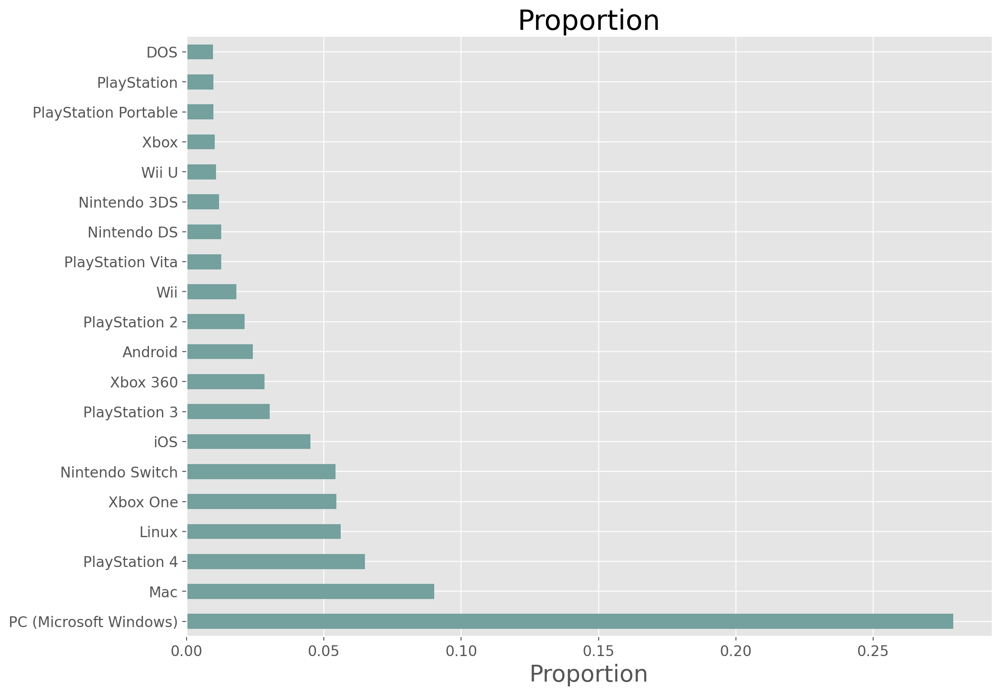

In [35]:
plot_proportions_for_top_n(df_ratings, col = 'platform_description', n = 20)

Seems like Windows games proportion (almost 30%) dominates in this dataset followed by Mac, PS4, Linux, Xbox One and Nintendo Switch.

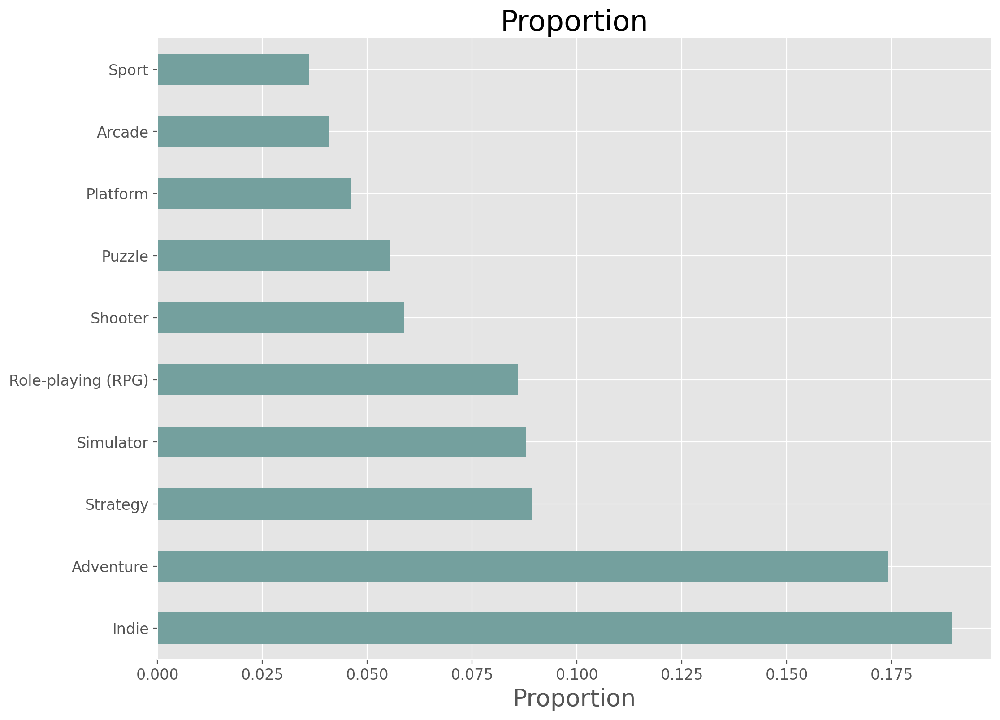

In [92]:
plot_proportions_for_top_n(df_ratings, col = 'genres_description', n = 10)

Most games here are categorized as Indie and Adventure genres.

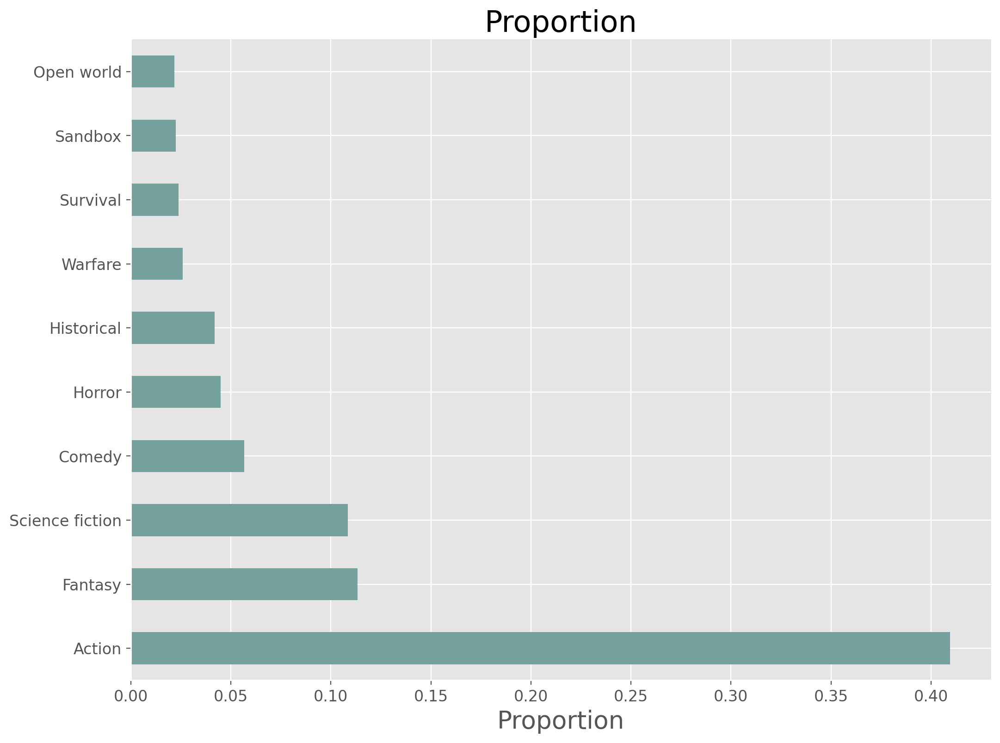

In [93]:
plot_proportions_for_top_n(df_ratings, col = 'themes_description', n = 10)

More than 40% of games are tagged with Action. The second most frequent theme is Fantasy which is not even close (only 12%).

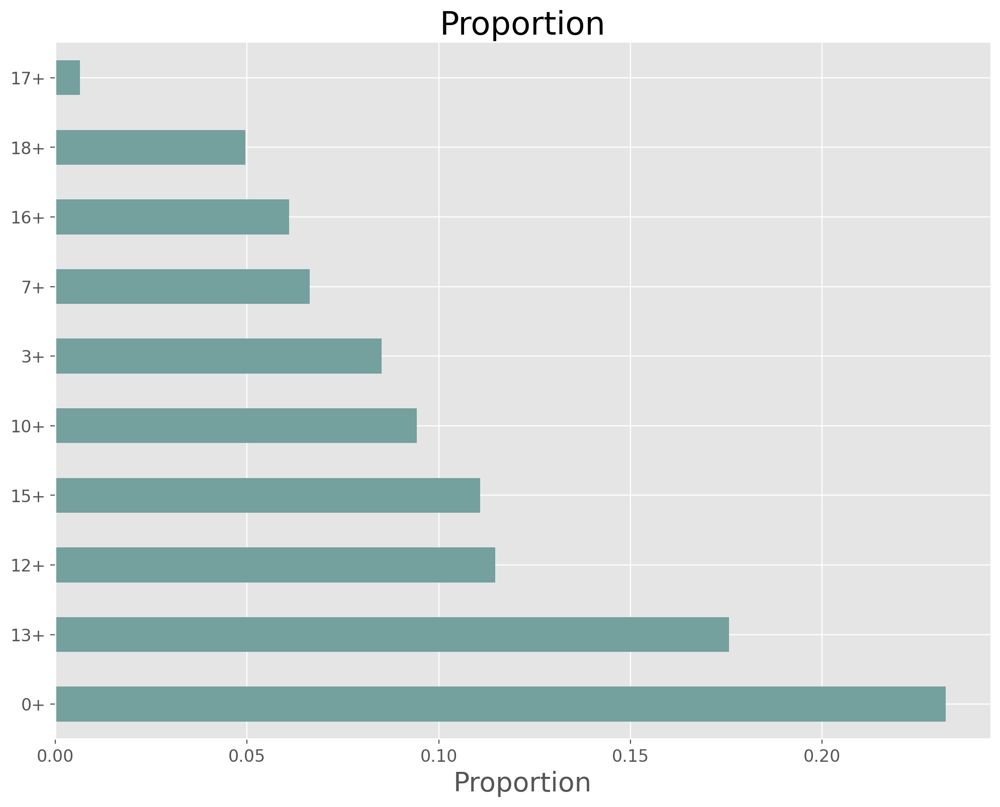

In [29]:
plot_proportions_for_top_n(df_ratings, col = 'age_group', n = 10)

Almost 25% of the games are for 0+. Mature games (16+, 17+, 18+) add up to only around 12% in the data.

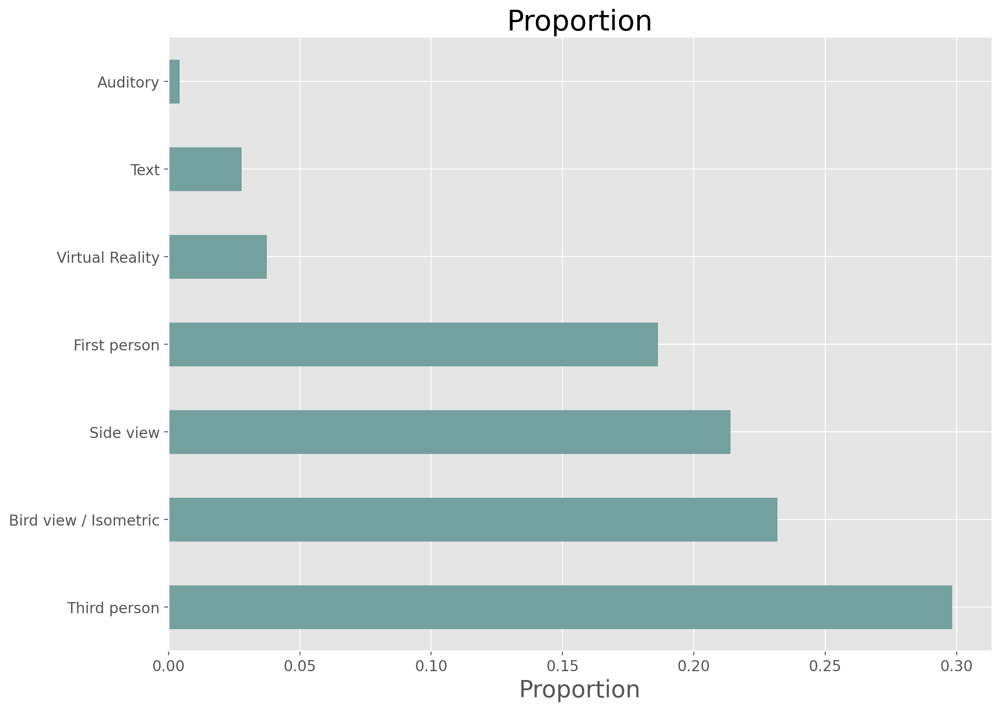

In [95]:
plot_proportions_for_top_n(df_ratings, col = 'player_perspectives_description', n = 7)

Almost 30% of the games have 3rd person view, 23% have top-down view, ~21% have side view (side scrolling games).

# 4. Bivariate Exploration

Coming to bivariate exploration, we will start by comparing the distributions among categories:

Because the histogram puts values into bins, it obscures some details. The CDF shows all unique values, so we can see where the exactly where each value falls.

Let's plot CDF and KDE plots.

If a random element is drawn from a distribution:
PMF (Probability Mass Function) is the probability that you
get exactly x and
CDF (Cumulative Distribution Function) is the probability that
you get a value <= x ,for a given value of x

Since total_rating has so many unique values (continuous random variable) PMF may be noisy and is as useful as CDF and KDE plots. PMF is applicable for discrete random variable.
A CDF, just like PMF, contains values and their probabilities; the difference is that the probabilities in the CDF are the the cumulative sum of the probabilities in the PMF.
KDE is a way of getting from a PMF, a probability mass function, to a PDF, a probability density function. This may be more suitable for this as total_rating has a lot of unique values.

In [118]:


def plot_kde(df  = df_ratings, col = 'platform_description', n = 10):

    
    df_exploded = df.apply(lambda x: x.explode() if x.name == col else x).reset_index()
    
    fig, ax = plt.subplots()
    name = "tab10"
    cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
    colors = cmap.colors  # type: list
    ax.set_prop_cycle(color=colors)

    #df_exploded = df_exploded['platform_description_description'].value_counts().nlargest(10)
    # Extract the top unique categories based on count
    categories = df_exploded[col].value_counts().nlargest(n).index
    # Filter out 0 ratings
    over_0 = df_exploded[df_exploded['total_rating'] > 0]
    over_0 = over_0[over_0[col].isin(categories)]     
    
    sns.kdeplot(x='total_rating', data=over_0, hue=col, fill=False, legend=True, common_norm=False)
        
    ax.set(title='KDE Plot of Categories')
    

    return plt.show();

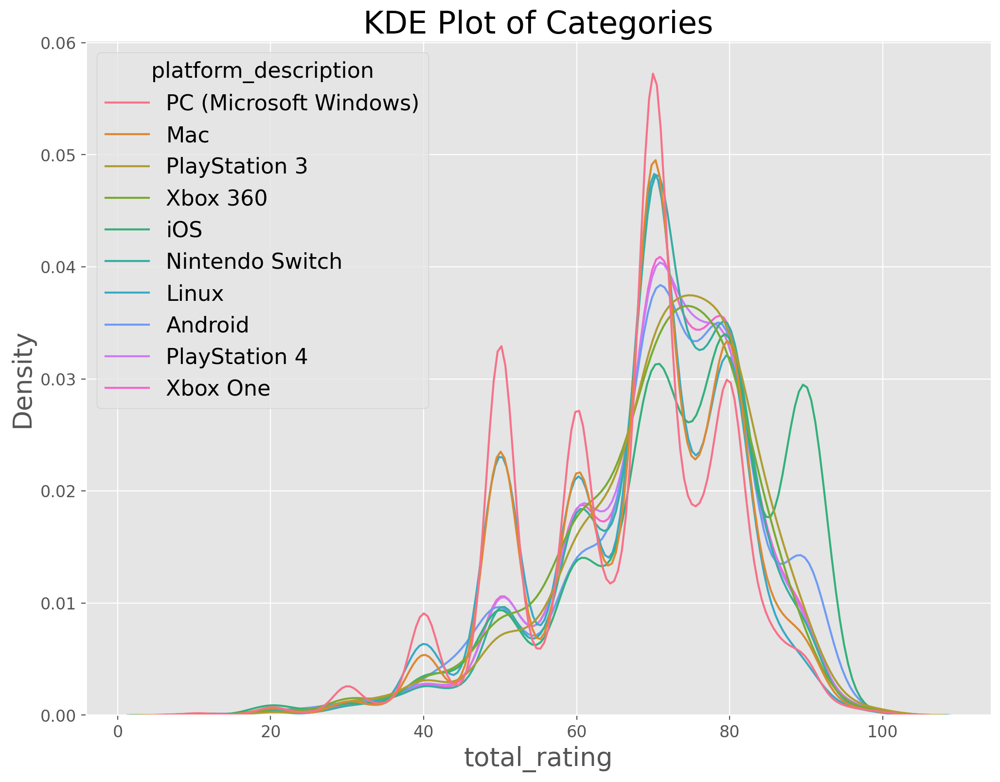

In [119]:
plot_kde(df  = df_ratings, col = 'platform_description', n = 10)

iOS games with a clear lead followed by android games have a higher rating than other platforms around 90s.
Xbox 360 and PS3 peak at above 75 and below 80 while others peak at 70.

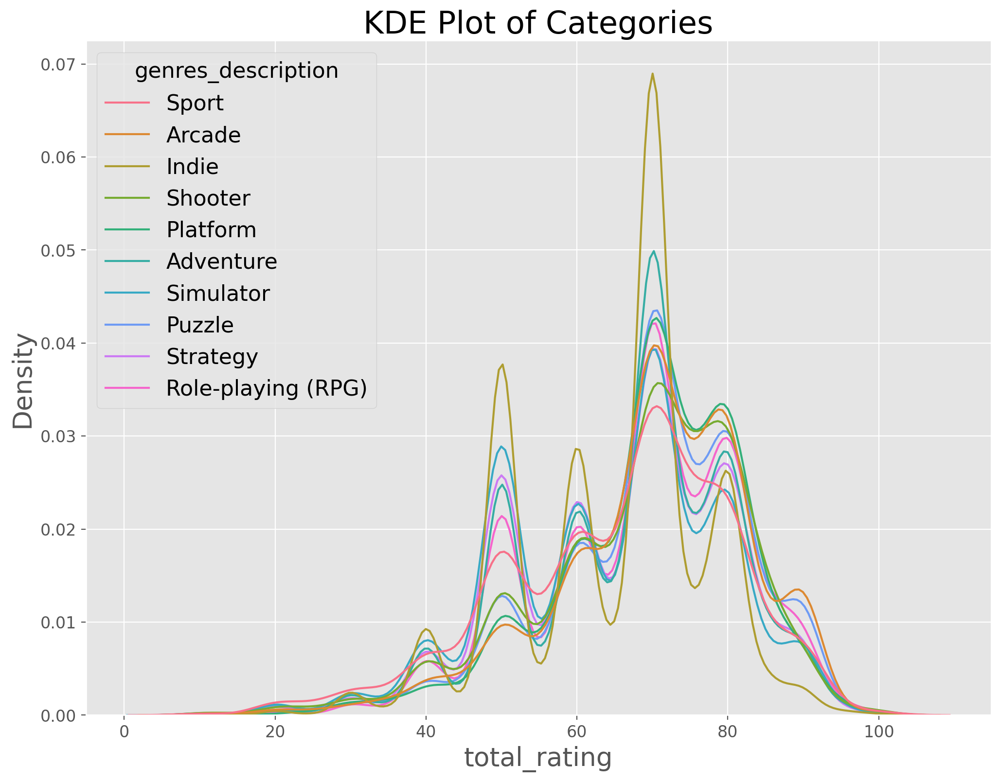

In [120]:
plot_kde(df  = df_ratings, col = 'genres_description', n = 10)

Arcade, puzzle and RPG games have more density compared to others around 90 (rating)

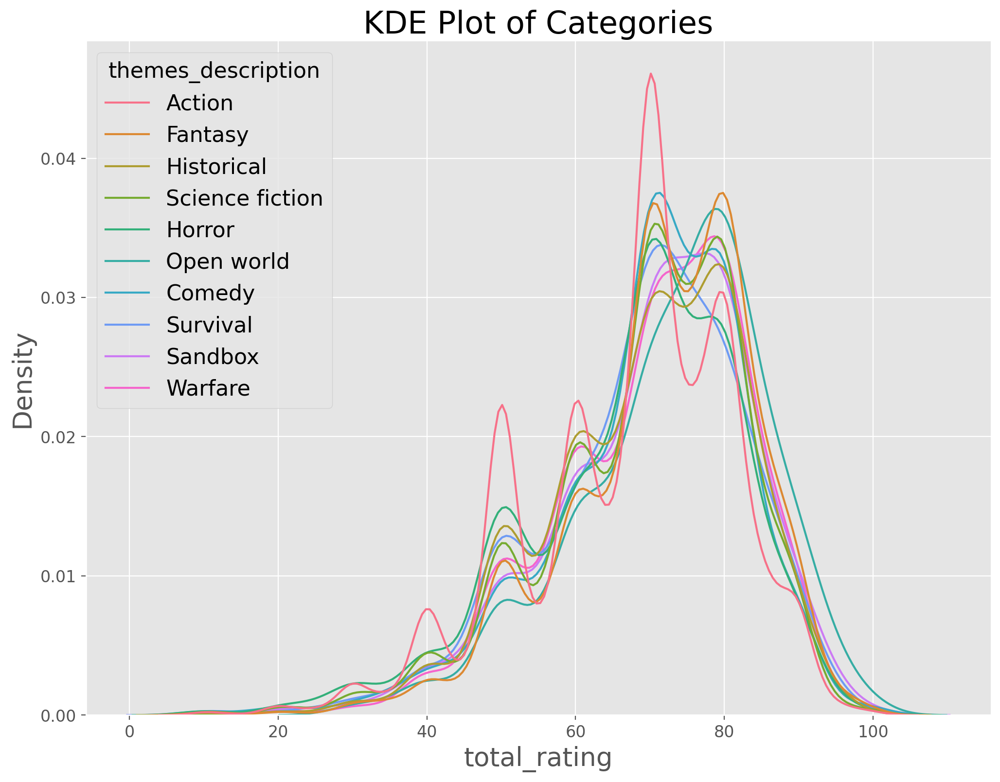

In [121]:
plot_kde(df  = df_ratings, col = 'themes_description', n = 10)

open world games have higher density above 80s than any other theme.

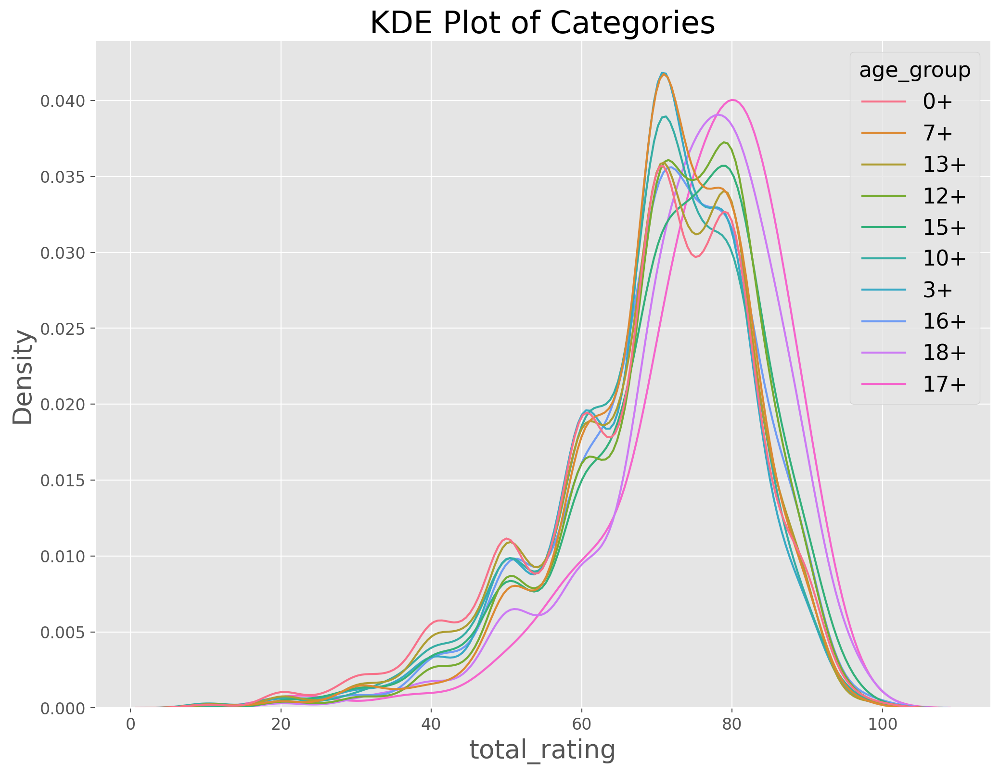

In [122]:
plot_kde(df  = df_ratings, col = 'age_group', n = 10)

Games that are age rated 'M' (or games that are for 17 or 18+) have more density at higher ratings.

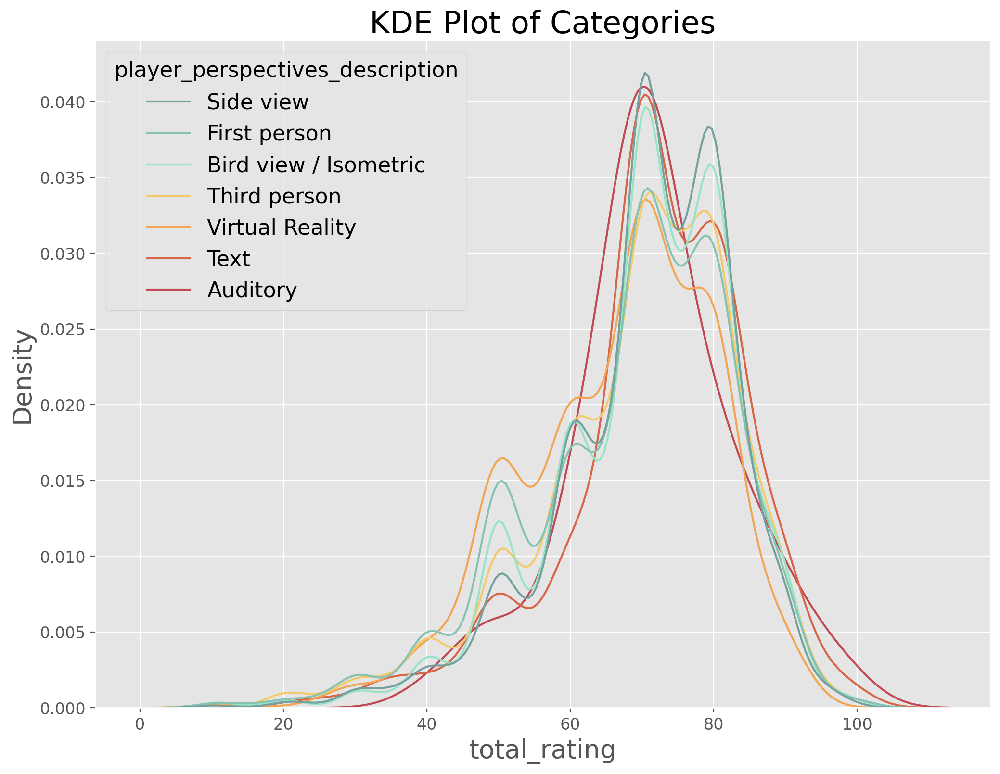

In [123]:
plot_kde(df  = df_ratings, col = 'player_perspectives_description', n = 10)

They all have the same distribution. Seems like the view does not matter for a game to have a high rating. VR games seem to have lowest densities above 70s and highest densities below 60s.

In [167]:
def plot_cdf(df  = df_ratings, col = 'platform_description', n = 10):

    
    df_exploded = df.apply(lambda x: x.explode() if x.name == col else x).reset_index()
    
    #name = "tab10"
    #cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
    #colors = cmap.colors  # type: list
    #ax.set_prop_cycle(color=colors)

    
    # Extract the top unique categories based on count
    categories = df_exploded[col].value_counts().nlargest(n).index
    # Filter out 0 ratings
    over_0 = df_exploded[(df_exploded['total_rating']) > 0]
    over_0 = df_exploded[df_exploded[col].isin(categories)]

    sns.ecdfplot(data=over_0, x="total_rating", hue=col, palette='tab10').set(title = 'CDF for Rating')
    
    
   
    

In [94]:
def plot_pmf(df  = df_ratings, col = 'platform_description', n = 10):

    fig, ax = plt.subplots()
    df_exploded = df.apply(lambda x: x.explode() if x.name == col else x).reset_index()
    
    name = "tab10"
    cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
    colors = cmap.colors  # type: list
    ax.set_prop_cycle(color=colors)

    #df_exploded = df_exploded['platform_description_description'].value_counts().nlargest(10)
    # Extract the top unique categories based on count
    categories = df_exploded[col].value_counts().nlargest(n).index
    # Filter out 0 ratings
    over_0 = df_exploded[df_exploded['total_rating'] > 0]

    for cat in categories:
        pmf_cat = Pmf.from_seq(over_0[over_0[col] == cat]['total_rating'])
        ax.plot(pmf_cat, label=cat, alpha = 0.5)
        #ax.bar(pmf_cat, alpha = 0.7, height = 0.7)

    ax.set(title='PMF of Rating',
        xlabel='Rating',
        ylabel='P(X = x)')

    ax.legend()

    return plt.show();

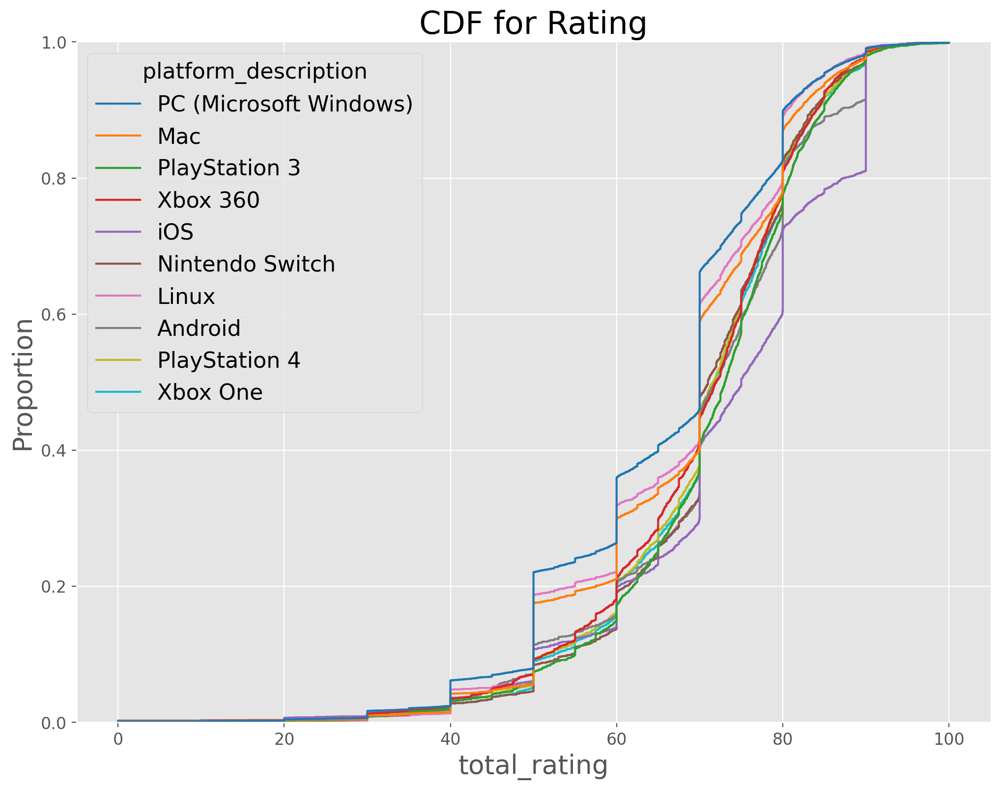

In [170]:
plot_cdf(df = df_ratings, col = 'platform_description', n = 10)

This one is a bit tricky to interpret. At first glance, we feel that iOS games proportion is very low compared to others below 90s but that's because the iOS games have many ratings at 90s or higher.
In other words, the probability that an iOS game has rating below 90 is the lowest compared to that of other platforms.

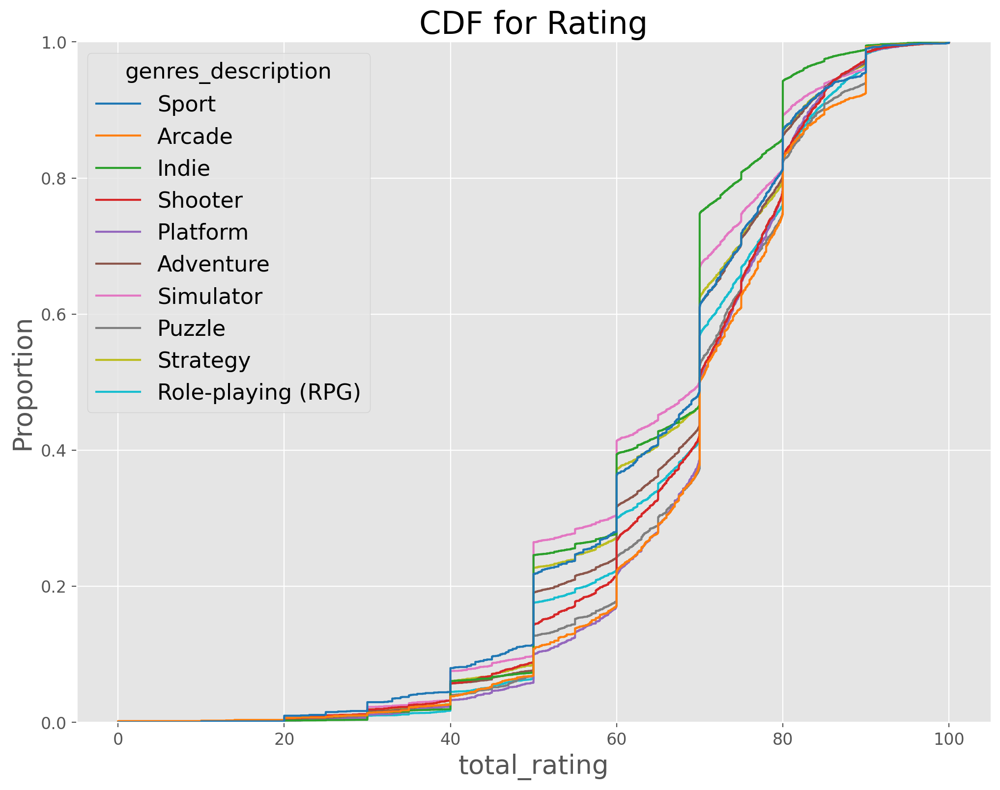

In [171]:
plot_cdf(df = df_ratings, col = 'genres_description', n = 10)

Sport and Simulator genres seem to be not doing so well. There's a 40% chance for a simulator game to have a rating of below 60.

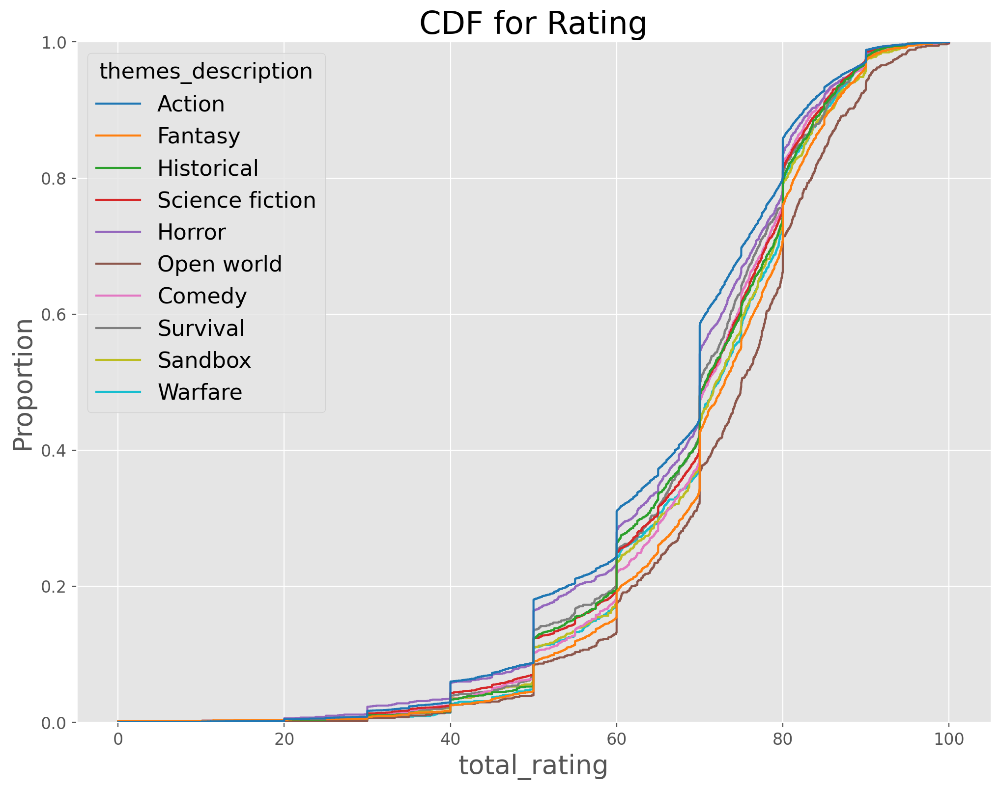

In [172]:
plot_cdf(df = df_ratings, col = 'themes_description', n = 10)

Action and Horror themed games have almost 30% chance to have a rating of less than 60.

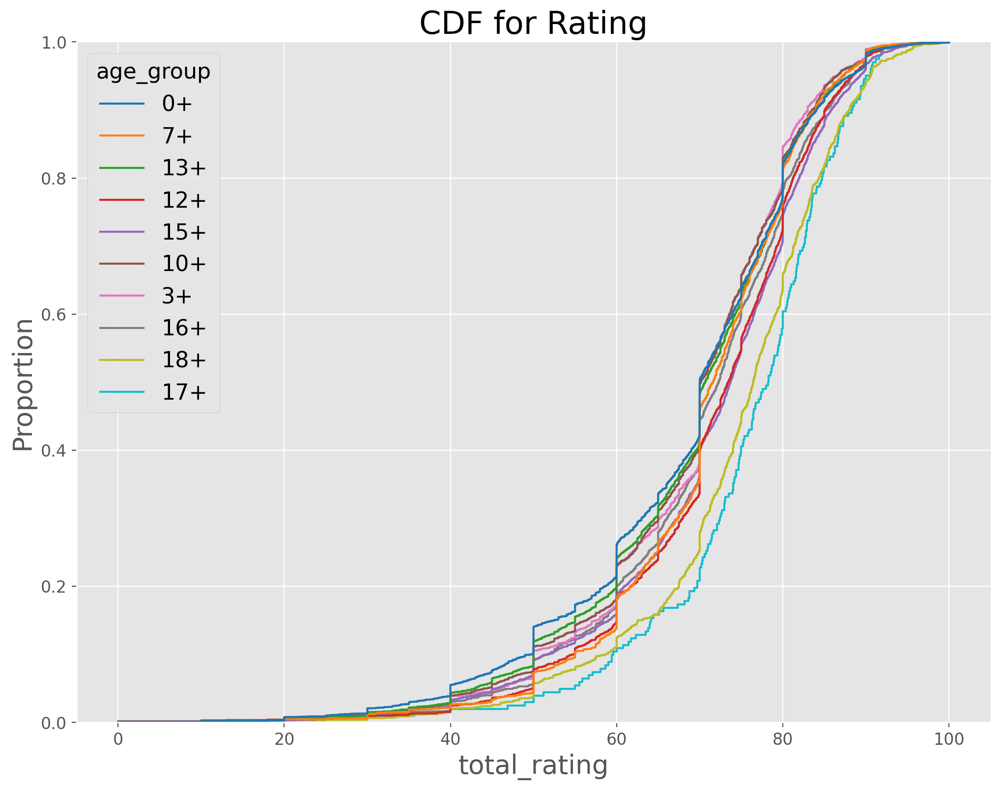

In [173]:
plot_cdf(df = df_ratings, col = 'age_group', n = 10)

Games meant for Everyone are not doing so well relatively to games meant for adults.

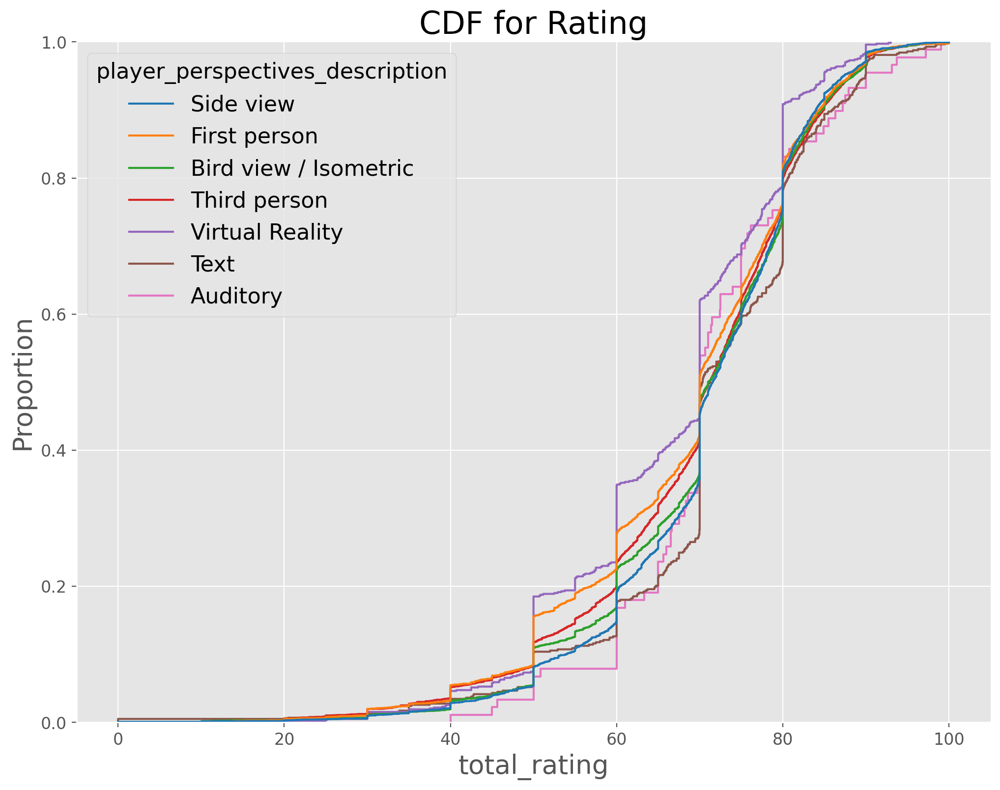

In [174]:
plot_cdf(df = df_ratings, col = 'player_perspectives_description', n = 10)

VR games performed worse while auditory and text games (though they are only extremely few) seem to be doing well relatively.

What would be interesting is to compare rating of the games across categories. Let's create boxplots. We can compare medians as box plots are not affected by skew in the ratings.

In [346]:
def boxplot_for_rating_across_categories(df = df_ratings, col = 'platform_description', hue_col = None, n = 10):

    df_exploded = df.apply(lambda x: x.explode() if x.name == col else x)

    categories = list(df_exploded[col].value_counts().nlargest(n).index)

    df_exploded = df_exploded[df_exploded[col].isin(categories)]
    
    ordered = df_exploded.groupby(col).median().sort_values(
    'total_rating', ascending=False).index

    fig, ax = plt.subplots()

    if(col == 'age_group'):
        sns.boxplot(x=col, y='total_rating', hue = hue_col, data=df_exploded, palette='husl',
                    order=["0+", "3+", "7+", "10+", "12+", "13+", "15+", "16+", "17+", "18+"])
    else:
        sns.boxplot(x=col, y='total_rating', hue = hue_col, data=df_exploded, palette='husl',
                    order = ordered)

    #ax.set_yscale('log')

    ax.set(title='Comparison of Ratings Between Categories',
        xlabel='', ylabel='Rating')

    # Rotate xtick labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60)

    # Set custom yticklabels
    #y_ticks = [0.3, 0.5, 1, 3, 5, 10, 30, 100, 300]
    #ax.set_yticklabels(y_ticks)

    return plt.show();

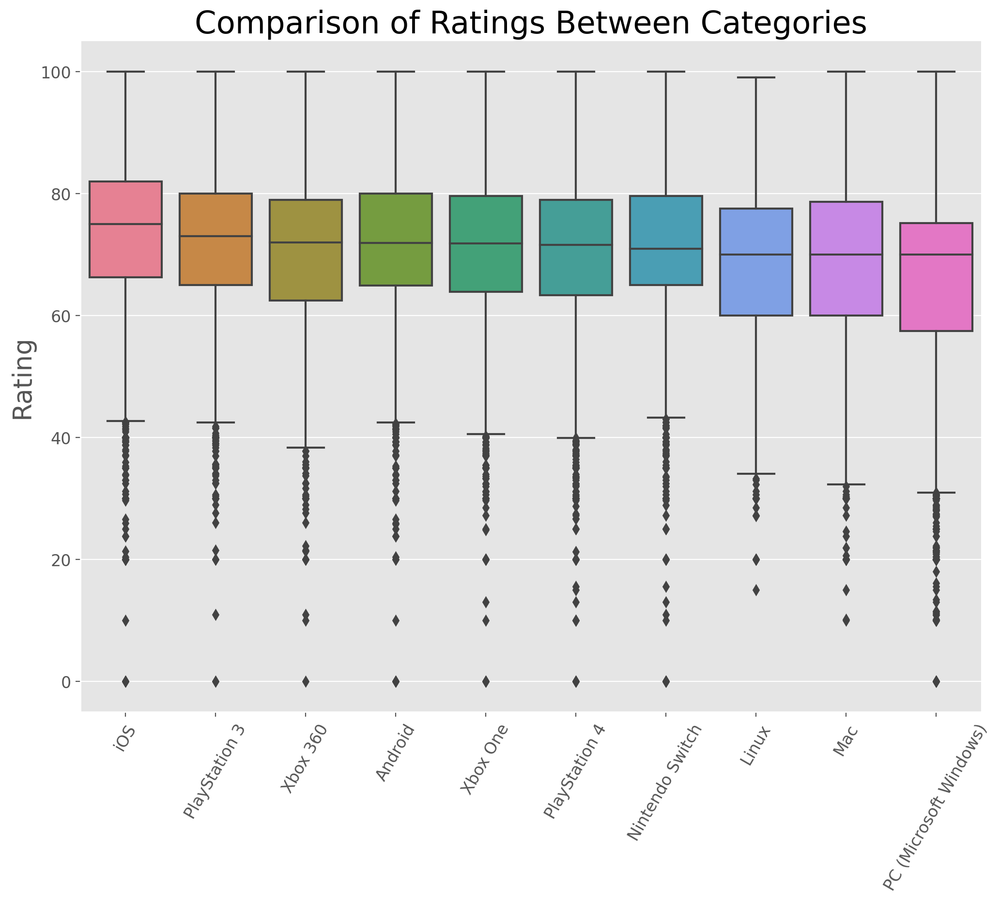

In [347]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'platform_description', n = 10)


iOS games have higher median rating compared to other platforms. My theory is that mobile apps have a more targeted way of asking for ratings (we all have seen 'enjoying this game? Rate it!') and making it really easy for people to tap on 5 stars. We could argue that the same applies for Android too but it has lower ratings relatively. This might be because iOS consumers spend far more per person than android users, making it a more appealing platform for developers to deliver better quality or it might be because android has to cater to thousands of phone models while iOS just needs to consider iphone and ipad models making it much simpler to develop and maintain games. Apple does have a great (and strict) moderation process that makes it harder for developers to push a bad quality app.

PS3 and Xbox 360 supported backward compatibility always, had larger time in market and had a huge library of great games but those games are included/tagged with PS4 and Xbox One in this dataset. So, I do not think that is the reason. PS3 and Xbox 360 had longer time in market before PS4 and Xbox One came and more games on those consoles became available. This may be one of the reasons why PS3 and Xbox 360 have slightly higher ratings than their next gen counterparts.

Windows ranks slightly lower than Linux and Mac. This may be because of the inherent bias in the games. Most games are made for Windows and only the games that are of good quality or from big franchises are made compatible with Linux and Mac. So they may have an edge over Windows when we try to compare ratings. Having said that, this is changing rapidly. Mac and Linux comaptible games are becoming increasingly common.

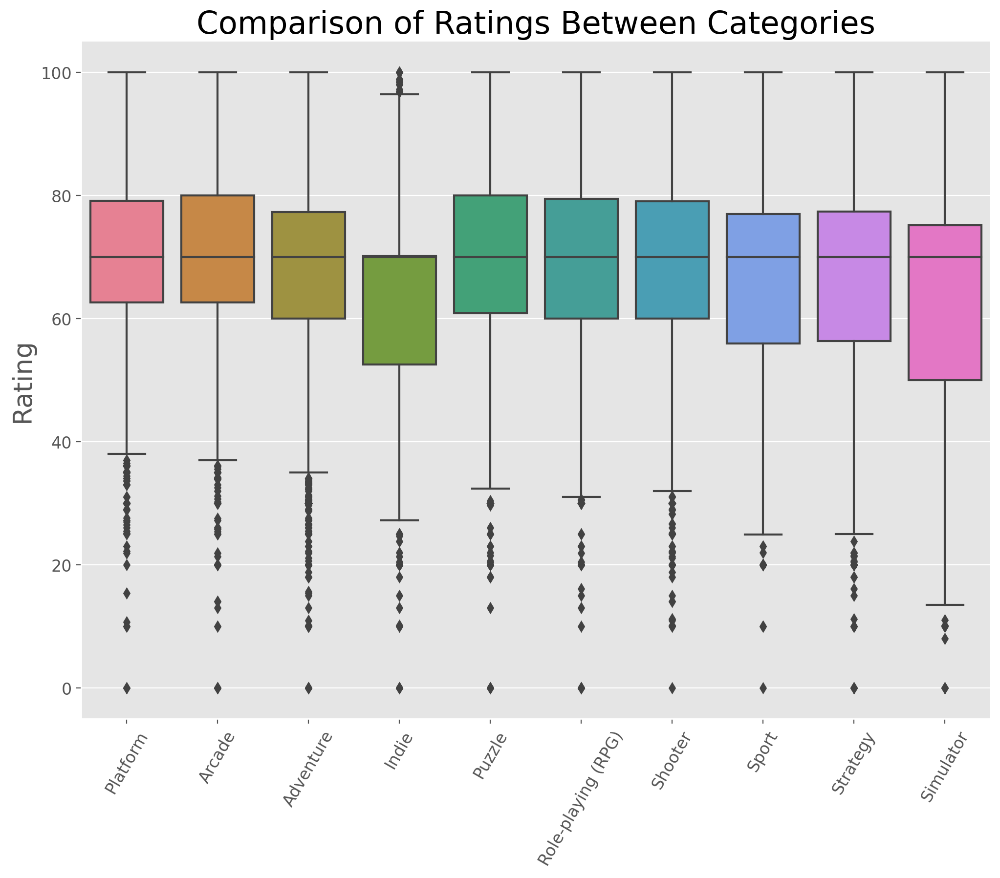

In [348]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'genres_description', n = 10)

Surprised to see how stable the median is regardless of a game genre. Simulator and Indie seem to have many lower ratings than other genres.

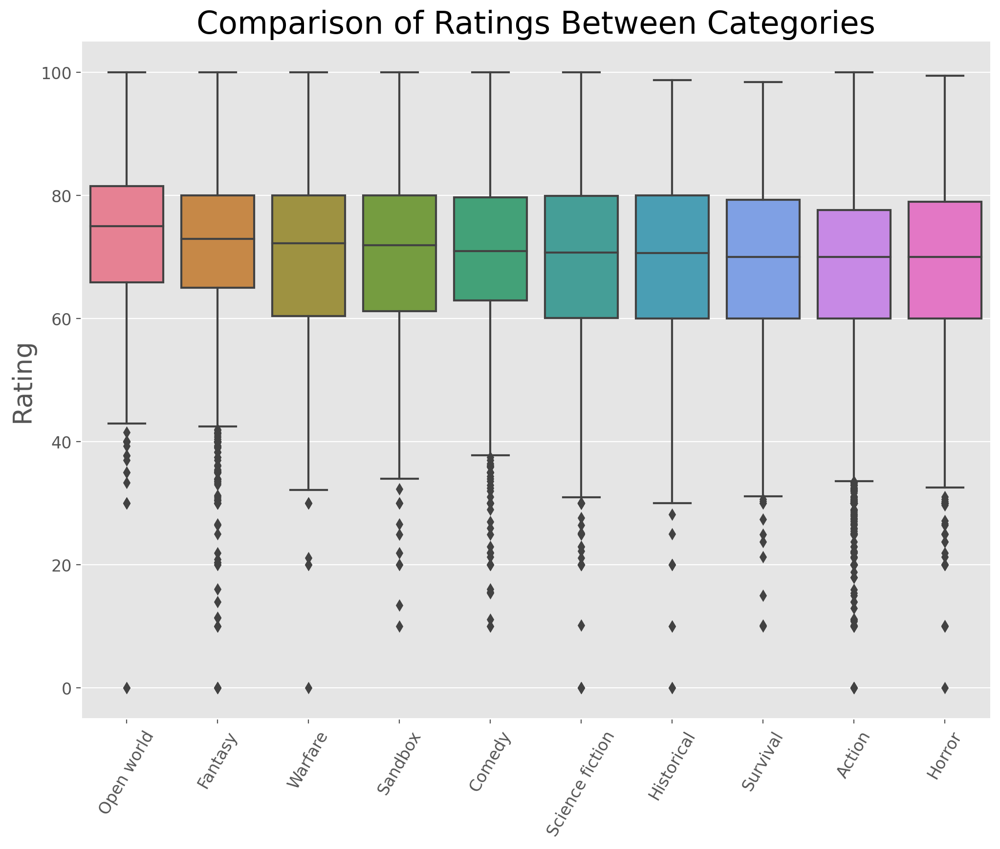

In [349]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'themes_description', n = 10)

Open world games clearly have higher rating distribution followed by Fantasy, Warfare and Sandbox. Seems like players love choice (Open world) and being to explore however they want to (Sandbox).

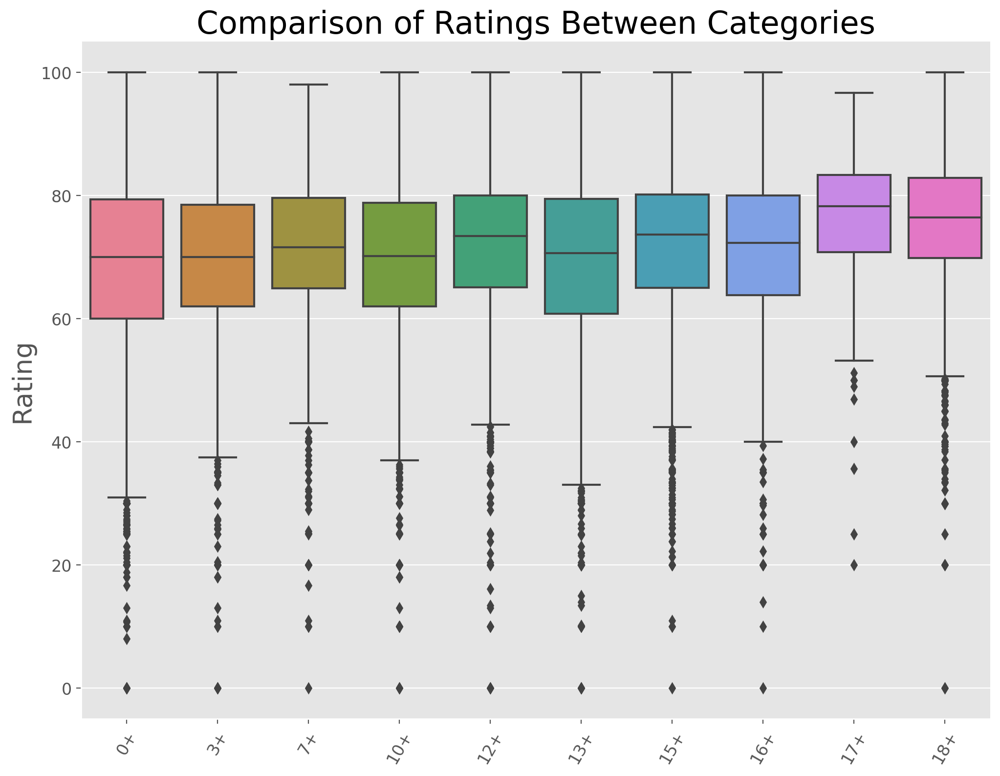

In [350]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'age_group', n = 10)

In general, games that have higher age requirement have higher ratings.

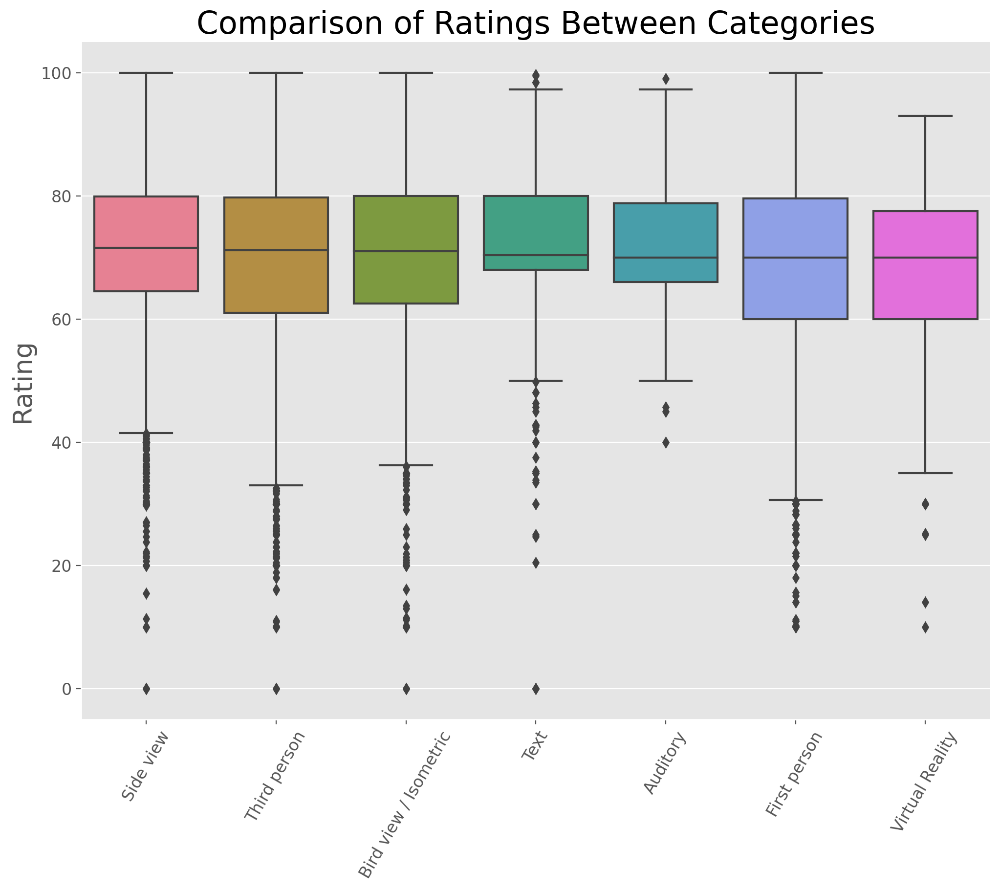

In [351]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'player_perspectives_description', n = 10)

Text and Auditory games have amazing IQRs but they are extremely few games in these groups relatively. Median-wise, player perspective in the game doesn't seem to matter.

Now, let's see if more ratings mean higher ratings.

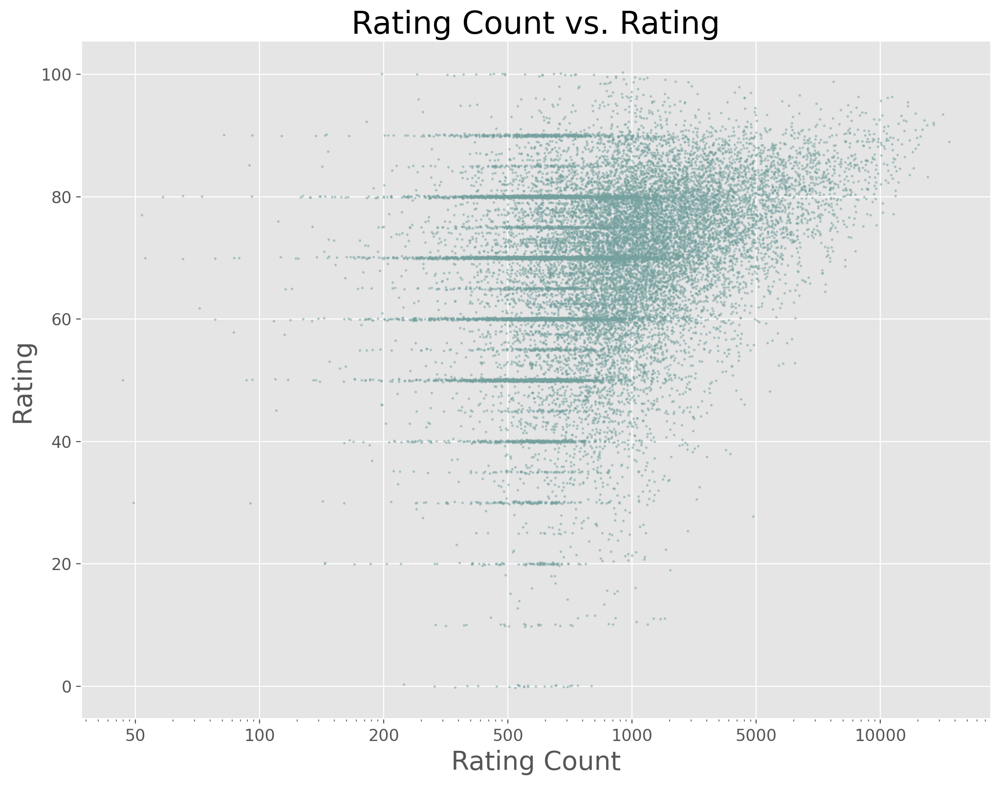

In [203]:
fig, ax = plt.subplots()

# Filter out 0 ratings
majority_rated = df_ratings[(df_ratings['total_rating_count'] > 0)]

# Jitter the ratings
rating_jittered = majority_rated['total_rating'] + np.random.normal(0, 0.12, len(majority_rated))
# Jitter the number of ratings
count_jittered = majority_rated['total_rating_count'] + np.random.normal(0, 1, len(majority_rated))

ax.plot(count_jittered, rating_jittered, 
        marker='o', linestyle='none', markersize=1, alpha=0.4)

# Use log scale
ax.set_xscale('log')
# Set custom tick labels
x_tick_labels = [1, 10, 50, 100, 200, 500, 1000, 5000, 10000, 50000, 100000]
ax.set_xticklabels(x_tick_labels)

# Label
ax.set(title='Rating Count vs. Rating',
       xlabel='Rating Count', 
       ylabel='Rating')

plt.show();

The graph appears to have a logarithmic curve. Although it may be weak, as the no. of ratings increase, the rating is higher.

We can check this by plotting a correlation matrix:

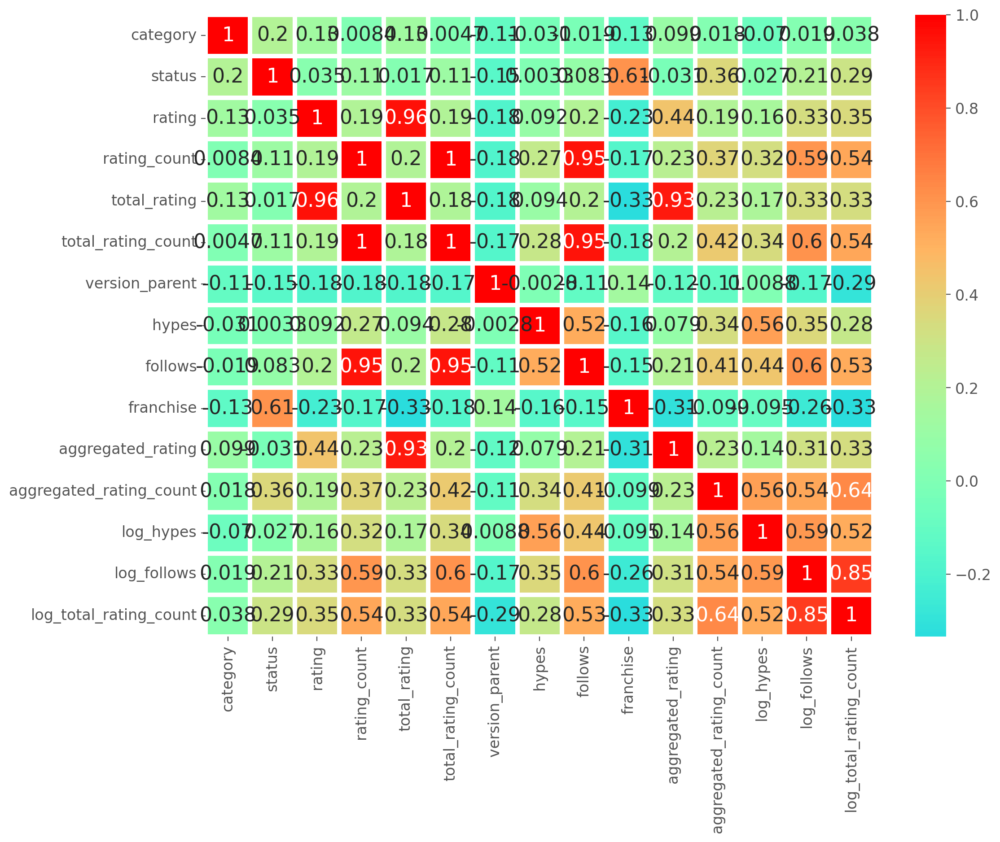

In [126]:
sns.heatmap(df_ratings.corr(), annot=True, 
            linewidths=3, center=0, cmap='rainbow');

Correlation matrix does not tell us much.

What's interesting is that follows and hype do not seem to have any siginificant correlation with how successful (total_rating) a game is.

Now, let's explore other angles. We will look at game ratings grouping them into single and multi player categories:

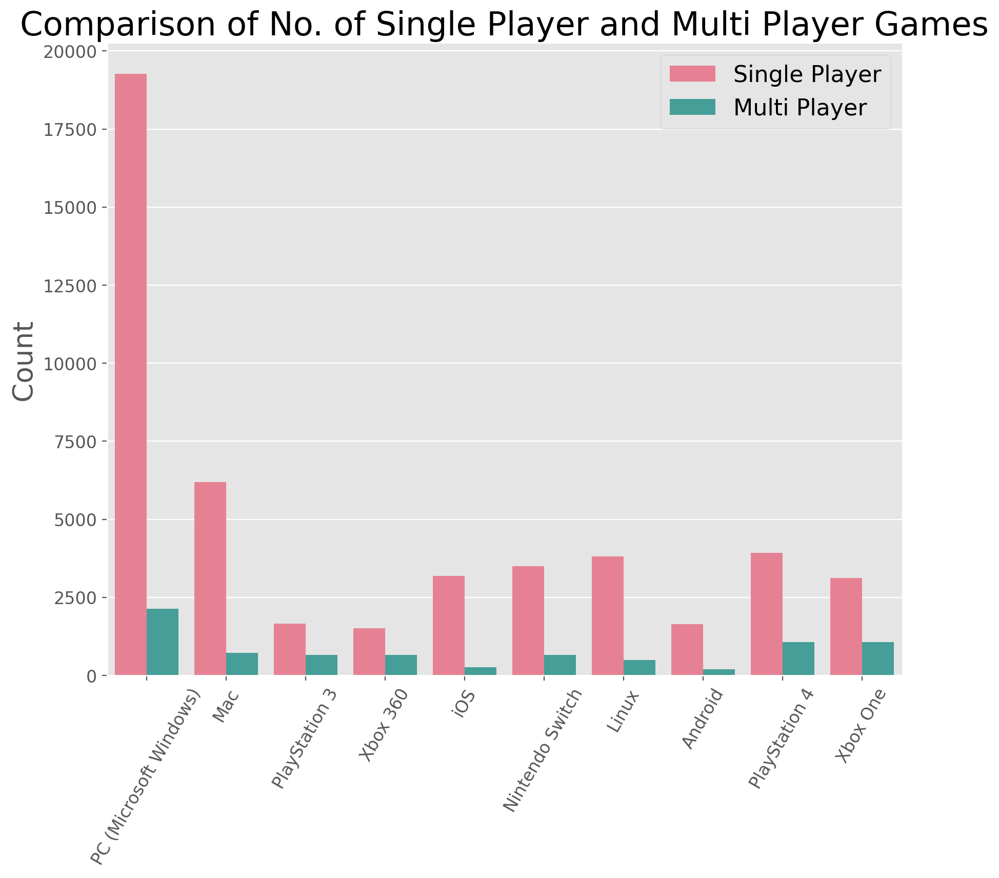

In [319]:
fig, ax = plt.subplots(figsize=(10, 8))
df_exploded = df_ratings.apply(lambda x: x.explode() if x.name == 'platform_description' else x)

categories = list(df_exploded['platform_description'].value_counts().nlargest(10).index)

sns.countplot(x='platform_description', hue='single_or_multi', data=df_exploded[df_exploded['platform_description'].isin(categories)],
              palette='husl')#['#74a09e','#f2a553']

ax.legend(['Single Player', 'Multi Player'], loc='upper right')
# Rotate xtick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=60)

ax.set(title='Comparison of No. of Single Player and Multi Player Games',
       xlabel='', ylabel='Count')

plt.show();

Not all games for all platforms are in this dataset. PS3 and Xbox 360 had 3 times more games than the ones listed here (< 2500 in data).

# 5. Multivariate Exploration

Honestly, at this point, I am little disappointed because the dataset did not turn out to be that interesting. To create more angles to explore, we will use the minimum and maximum installs columns. Looking at the dataset documentation, they show estimated minimum and maximum installs.

We will take the mean of the two columns which would be a better estimate for the true install count:

We will see if there is a relationship between rating and install count. We will also group the plots into paid and free apps.:

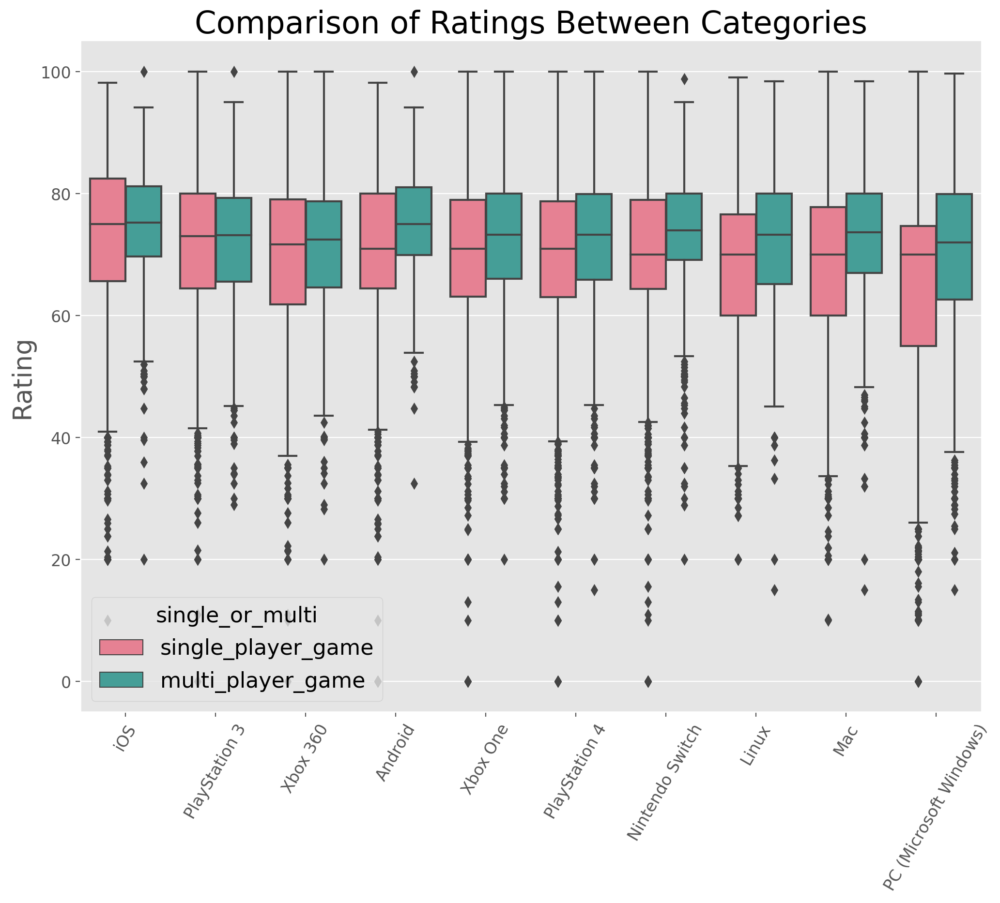

In [352]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'platform_description', hue_col = 'single_or_multi', n = 10)

While most platforms have multi player games rated higher than single player games, Mac, Android and Nintendo Switch multi player games have a significantly higher rating distribution than that of the single player games'.

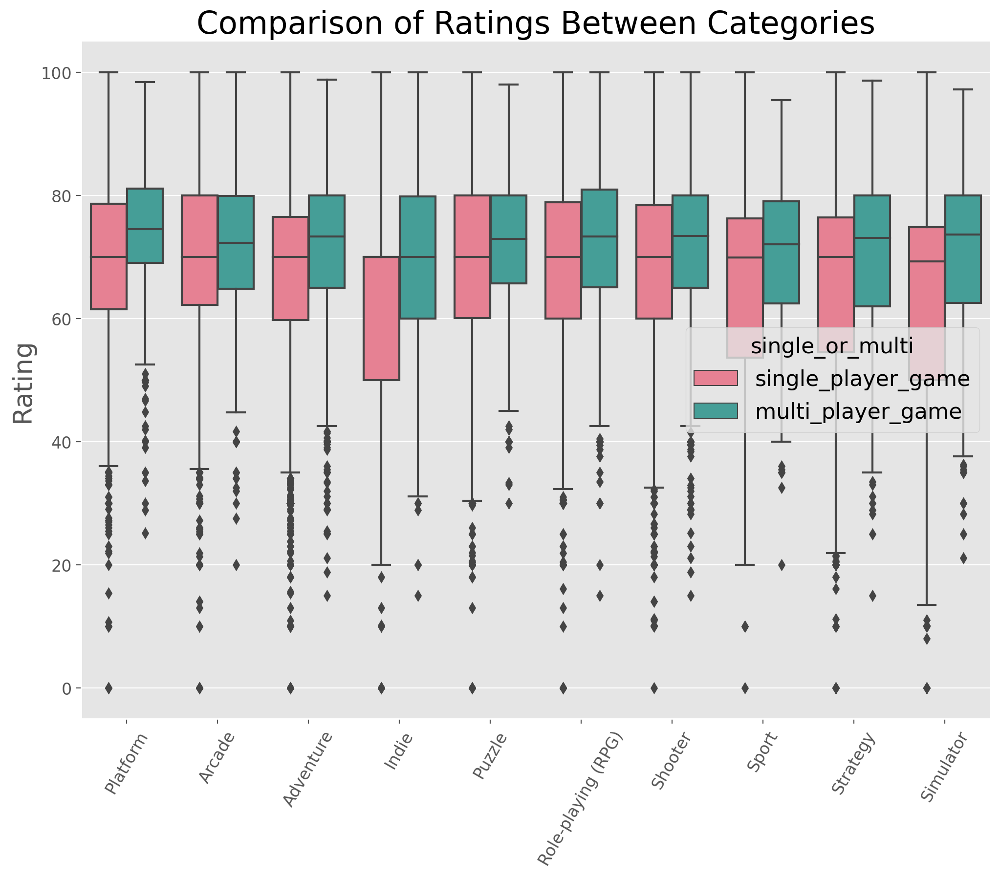

In [353]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'genres_description', hue_col = 'single_or_multi', n = 10)

Indie and Simulator genres seem to have much better rating distribution for multi player games than single player games. For single player games, genre doesn't matter much as all of the have almost the same median.

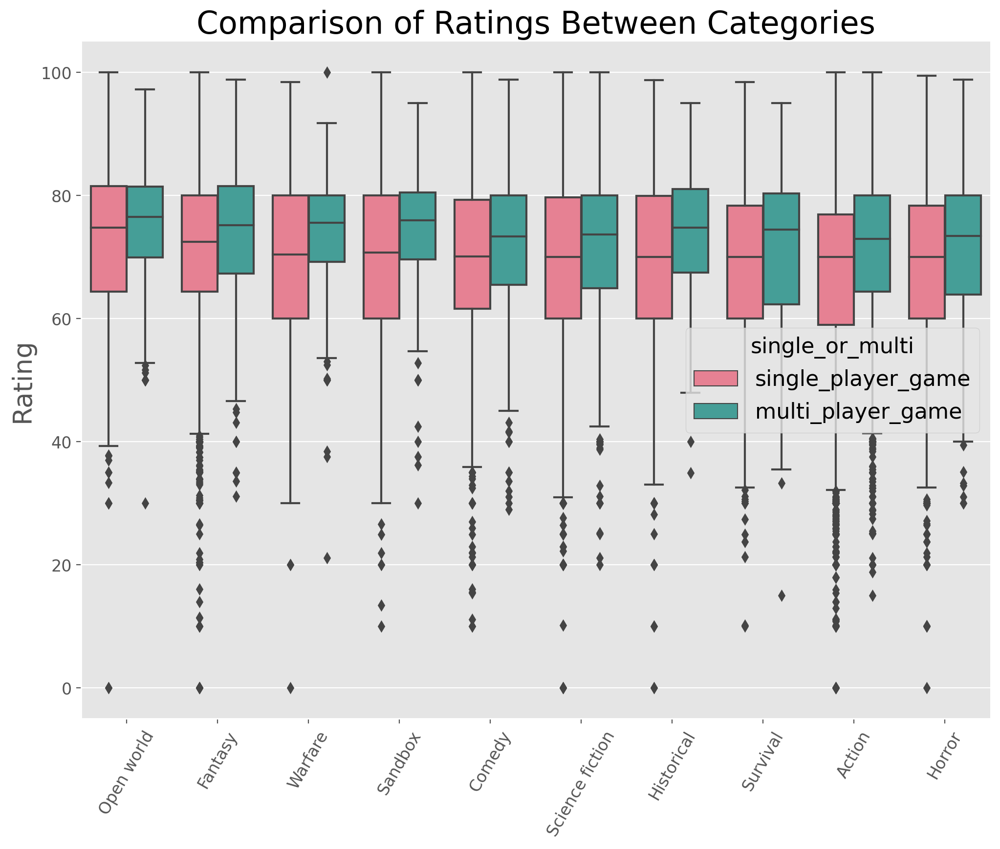

In [354]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'themes_description', hue_col = 'single_or_multi', n = 10)

Fantasy and Open World themes have higher ratings for single player games,  while Sandbox, Open world and Warfare have higher ratings for multi player games

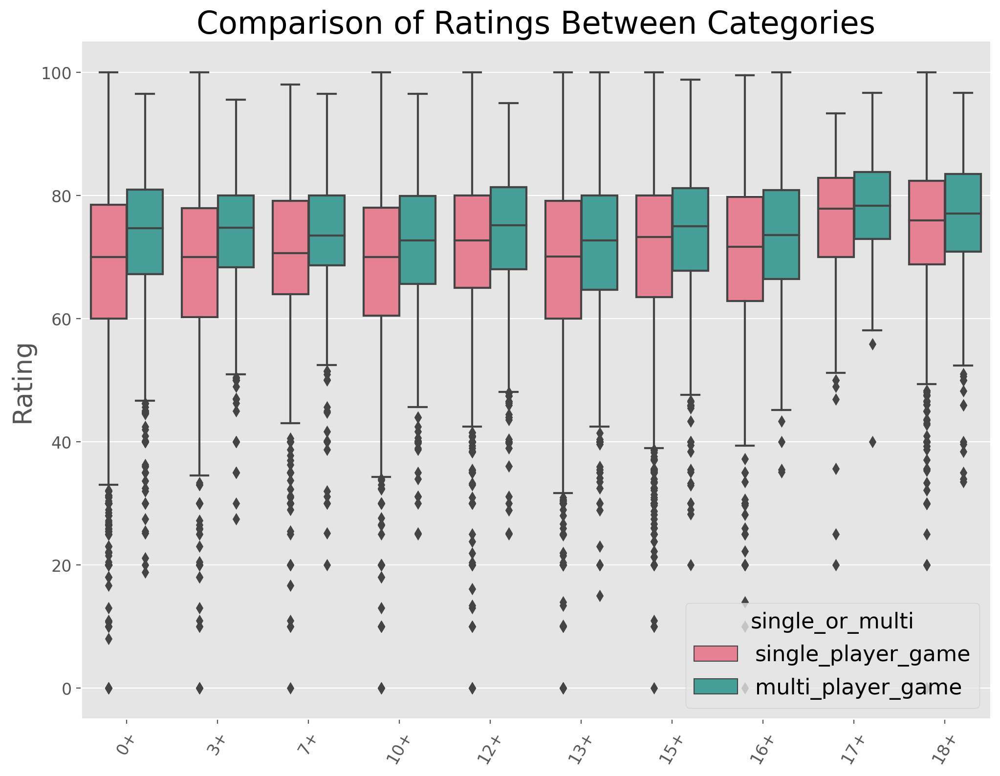

In [355]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'age_group', hue_col = 'single_or_multi', n = 10)

The rating distribution gap between single player and multi player games seems to decrease as the age increases. Gap is wider for 0+ and 3+ while it is narrow for 17+ and 18+ groups.

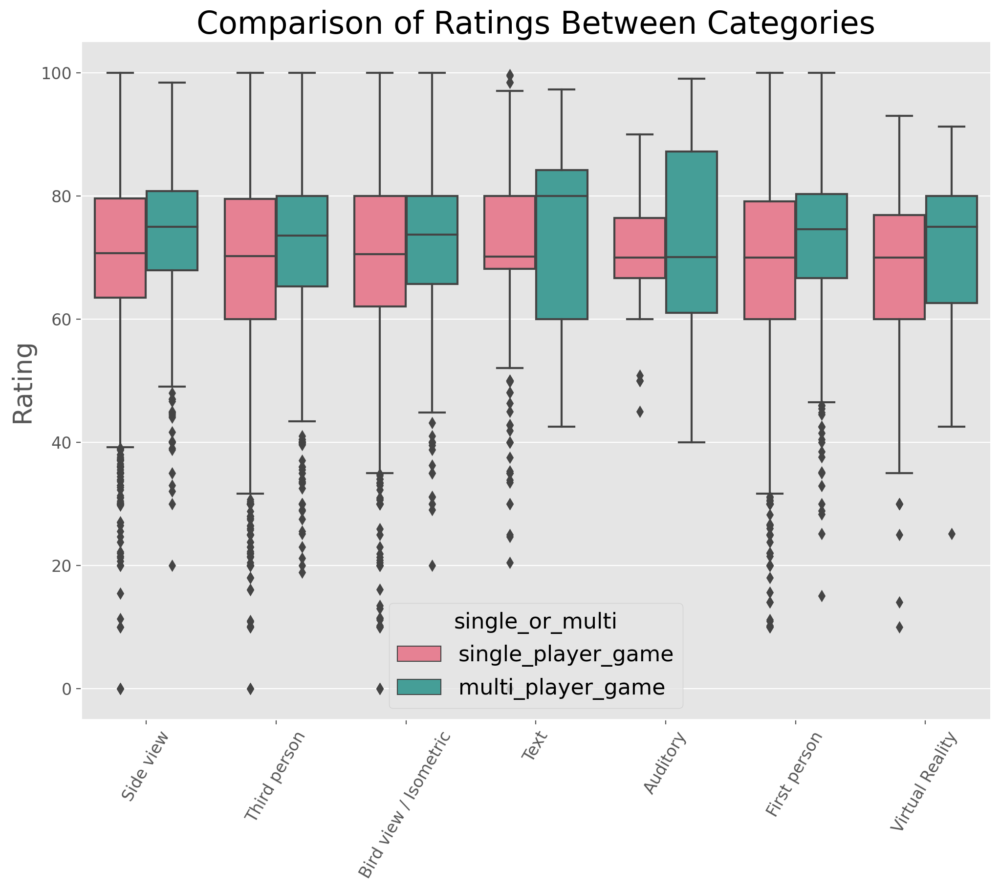

In [356]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'player_perspectives_description', hue_col = 'single_or_multi', n = 10)

Interesting to see that text based (interactive fiction) single player and multi player games seem to have relatively higher rating distribution even though they are not popular (they constitute less than 5% of the total proportion as we have seen above). Only in Auditory, we see same median rating for single and multiplayer games while in the rest, multiplayer games rating is much better.

A couple interesting things from the above plot: Education and Books categories have the same median rating. Also, Tools and Business apps are generally lower rated than other categories. But it seems that the fact that app is free or paid does not have any effect ont its rating. 

Let's clean the columns a bit.

age_group in the current form doesn't make much sense as each game has multiple age group values. 0+, 12+ can be interpreted in the same way as 0+.
Let's take only the first age limit value from the age_group column and re-categorize them into 3 major groups - Everyone, Teen, Mature for our analysis

Similarly, although genres and themes have multiple categories, let's just take the first primary category in these columns for convenience.
For example, a game may belong to fighting, hack and slash, adventure categories but let us just consider it as a fighting game.

In [357]:
df_ratings.first_release_date.unique()
df_ratings['release_year'] = pd.DatetimeIndex(df_ratings['first_release_date']).year
df_ratings.release_year.unique()

array(['2010-04-20T00:00:00.000000000',                           'NaT',
       '2020-02-20T00:00:00.000000000', ...,
       '2012-05-18T00:00:00.000000000', '2021-11-04T00:00:00.000000000',
       '2010-08-30T00:00:00.000000000'], dtype='datetime64[ns]')

array([2010.,   nan, 2020., 2017., 2001., 2009., 2016., 2022., 2008.,
       2014., 2011., 2015., 2018., 2019., 1987., 1997., 2004., 1986.,
       2003., 2005., 2013., 1996., 2012., 2002., 2000., 1984., 1993.,
       1994., 1995., 1992., 2007., 1990., 1988., 2006., 1989., 1998.,
       1999., 2021., 1991., 1981., 1985., 1982., 1979., 1983., 1958.,
       1977., 1978., 1971., 1975., 1980., 1976., 1972., 1969., 1973.])

In [358]:
df_cleaned = df_ratings.copy()

df_cleaned['age_group_clean'] = df_cleaned['age_group'].str[0]

#re-grouping age groups
df_cleaned['age_group_clean'] = df_cleaned['age_group_clean'].replace(['0+', '3+', '7+', '10+'], 'Everyone')
df_cleaned['age_group_clean'] = df_cleaned['age_group_clean'].replace(['12+', '13+', '14+', '15+'], 'Teen')
df_cleaned['age_group_clean'] = df_cleaned['age_group_clean'].replace(['16+', '17+', '18+'], 'Mature')

df_cleaned['genres_description_clean'] = df_cleaned['genres_description'].str[0]
df_cleaned['themes_description_clean'] = df_cleaned['themes_description'].str[0]
df_cleaned['player_perspectives_clean'] = df_cleaned['player_perspectives_description'].str[0]



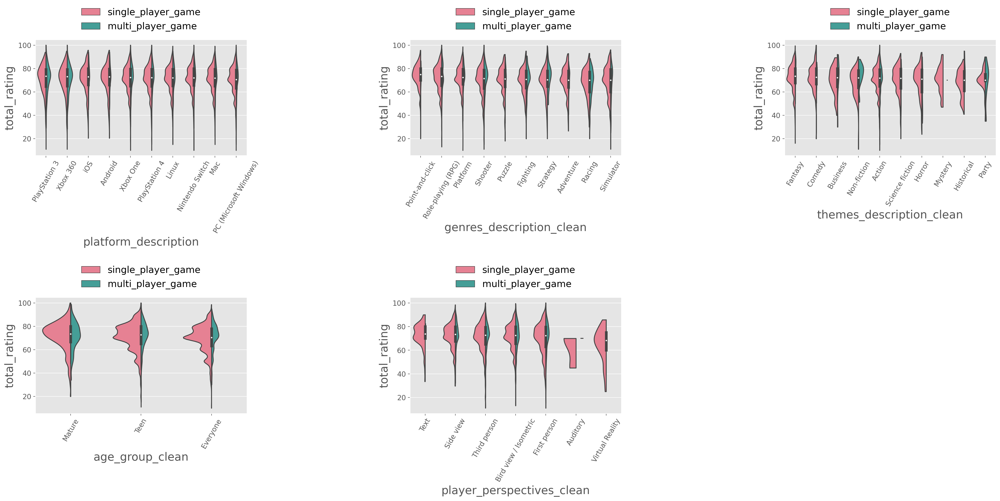

In [359]:
# Let's unpack this df based on platforms
df_cleaned_exploded = df_cleaned.apply(lambda x: x.explode() if x.name == 'platform_description' else x).reset_index()


# Consider top categories. Too many categories will not be useful.
platform_categories = list(df_cleaned_exploded['platform_description'].value_counts().nlargest(10).index)
genres_categories = list(df_cleaned_exploded['genres_description_clean'].value_counts().nlargest(10).index)
themes_categories = list(df_cleaned_exploded['themes_description_clean'].value_counts().nlargest(10).index)
age_categories = list(df_cleaned_exploded['age_group_clean'].value_counts().nlargest(3).index)
player_perspectives_categories = list(df_cleaned_exploded['player_perspectives_clean'].value_counts().nlargest(10).index)

df_cleaned_exploded.release_year.isna().sum()

df_cleaned_exploded.release_year.unique()
# Filtering the data for only top categories in each column
df_cleaned_exploded = df_cleaned_exploded[(df_cleaned_exploded['total_rating'] > 0) &
                                          (df_cleaned_exploded['platform_description'].isin(platform_categories)) &
                                          (df_cleaned_exploded['genres_description_clean'].isin(genres_categories)) &
                                          (df_cleaned_exploded['themes_description_clean'].isin(themes_categories)) &
                                          (df_cleaned_exploded['age_group_clean'].isin(age_categories)) &
                                          (df_cleaned_exploded.release_year > 2011)]
df_cleaned_exploded.head()
selected_features = ["platform_description", "genres_description_clean",
                     "themes_description_clean", "age_group_clean", "player_perspectives_clean"]

""" fig, axs = plt.subplots(ncols=5)
sns.violinplot(x=selected_features[0], y='total_rating', data=df_cleaned_exploded, ax=axs[0], palette='Set2',split=True,
               hue='single_or_multi', hue_order=['single_player_game','multi_player_game'], inner='box')
sns.violinplot(x=selected_features[1], y='total_rating', data=df_cleaned_exploded, ax=axs[1], palette='Set2',split=True,
               hue='single_or_multi', hue_order=['single_player_game','multi_player_game'], inner='box')
sns.violinplot(x=selected_features[2], y='total_rating', data=df_cleaned_exploded, ax=axs[2], palette='Set2',split=True,
               hue='single_or_multi', hue_order=['single_player_game','multi_player_game'], inner='box')
sns.violinplot(x=selected_features[3], y='total_rating', data=df_cleaned_exploded, ax=axs[3], palette='Set2',split=True,
               hue='single_or_multi', hue_order=['single_player_game','multi_player_game'], inner='box')
sns.violinplot(x=selected_features[4], y='total_rating', data=df_cleaned_exploded, ax=axs[4], palette='Set2',split=True,
               hue='single_or_multi', hue_order=['single_player_game','multi_player_game'], inner='box') """



# Create a figure with 2 x 3 subplots
fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(24, 12))# figsize=(16, 8)figsize=(24, 12)
axes[1][2].set_visible(False)
axes[1][0].set_position([0.24,0.125,0.228,0.343])
axes[1][1].set_position([0.55,0.125,0.228,0.343])
# Loop through these features and plot entries from each feature against `total_rating`
for col, ax in zip(selected_features, axes.ravel()):
    #get order of the medians (highest to lowest) to display
    ordered = df_cleaned_exploded.groupby(col).median().sort_values(
    'total_rating', ascending=False).index
    sns.violinplot(data=df_cleaned_exploded, x=col, y="total_rating", palette="husl",
                   split=True, hue="single_or_multi", hue_order = ["single_player_game", "multi_player_game"], ax=ax, inner='box', scale = 'count', cut = 0, order = ordered)
    # Rotate xticks
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60)
    sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1), ncol=1, title=None, frameon=False)
   

                 
plt.tight_layout();

In [360]:
df_cleaned_exploded.to_csv("df_cleaned_exploded.csv", index = False)


In [370]:
# Create a figure with 2 x 3 subplots
fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(100, 20))# figsize=(16, 8)figsize=(24, 12)
axes[1][2].set_visible(False)
axes[1][0].set_position([0.24,0.125,0.228,0.343])
axes[1][1].set_position([0.55,0.125,0.228,0.343])

# Loop through these features and plot entries from each feature against `total_rating`
for col, ax in zip(selected_features, axes.ravel()):
    sns.violinplot(data=df_cleaned_exploded, x='release_year', y="total_rating", palette="Set2",
                hue = col, ax=ax)#hue_order = ["single_player_game", "multi_player_game"]
    # Rotate xticks
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60)
    sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False)
   

                 
plt.tight_layout();


### How do the ratings vary year by year?

In [372]:
def boxplot_for_rating_by_cat(df = df_cleaned_exploded, x = 'release_year', y = 'total_rating',
                              hue = None, col = 'platform_description', n = 10):

    g = sns.catplot(
        x=x, 
        y=y, 
        data=df,
        palette='husl',
        height=3, aspect=1.5,
        kind='box', 
        hue=hue,
        #hue_order= ['single_player_game', 'multi_player_game'],
        col=col,
        col_wrap=2)
    g.set_titles(
    '{col_name}');
    g.set_xticklabels(
    rotation=45, ha='right')

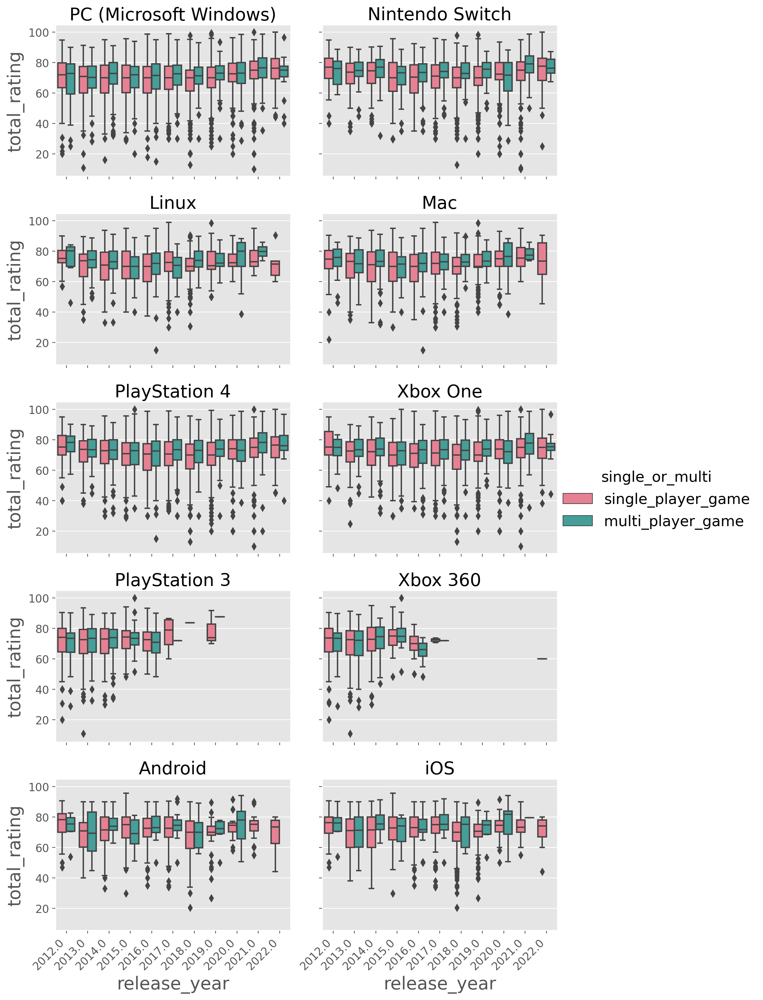

In [373]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'platform_description')

PS3 and Xbox 360 production stopped around 2017 roughly. I am skeptical of the data for these platforms after that year.
All ratings seem to be on an increasing trend from 2018 although data seems to be incomplete in the last 2 years.

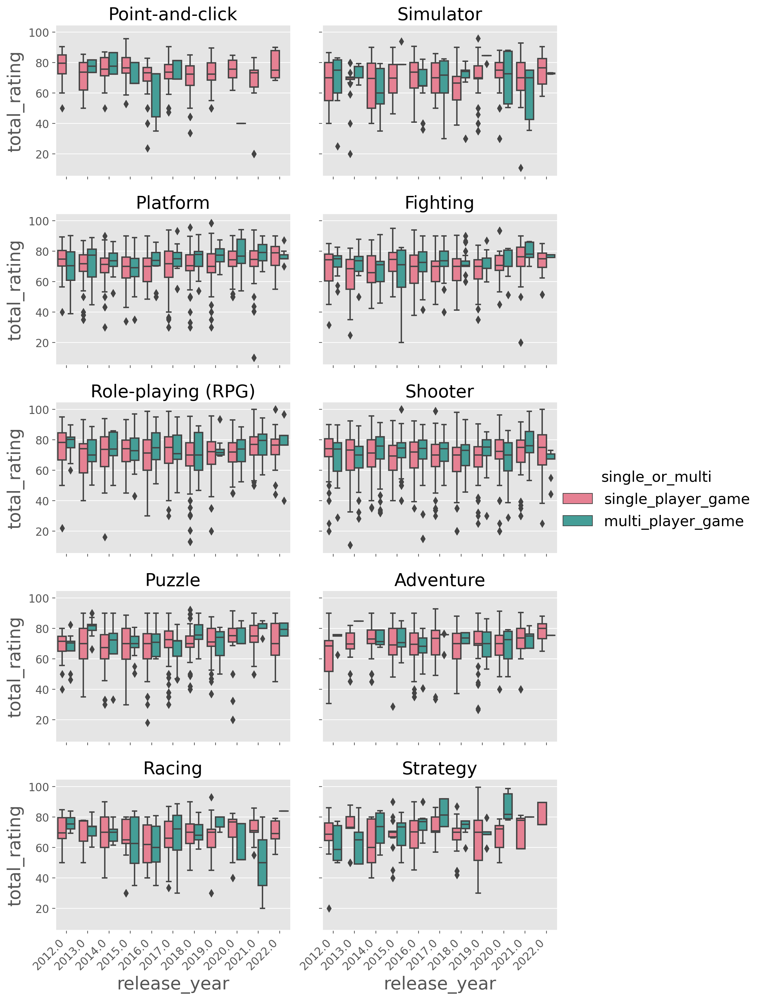

In [374]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'genres_description_clean')

Strategy games have improved a lot over the years.
Racing multi player games seem to be going down.

Puzzle, RPG, Platform, Adventure, Fighting seem to have an increasing trend from the last few years.

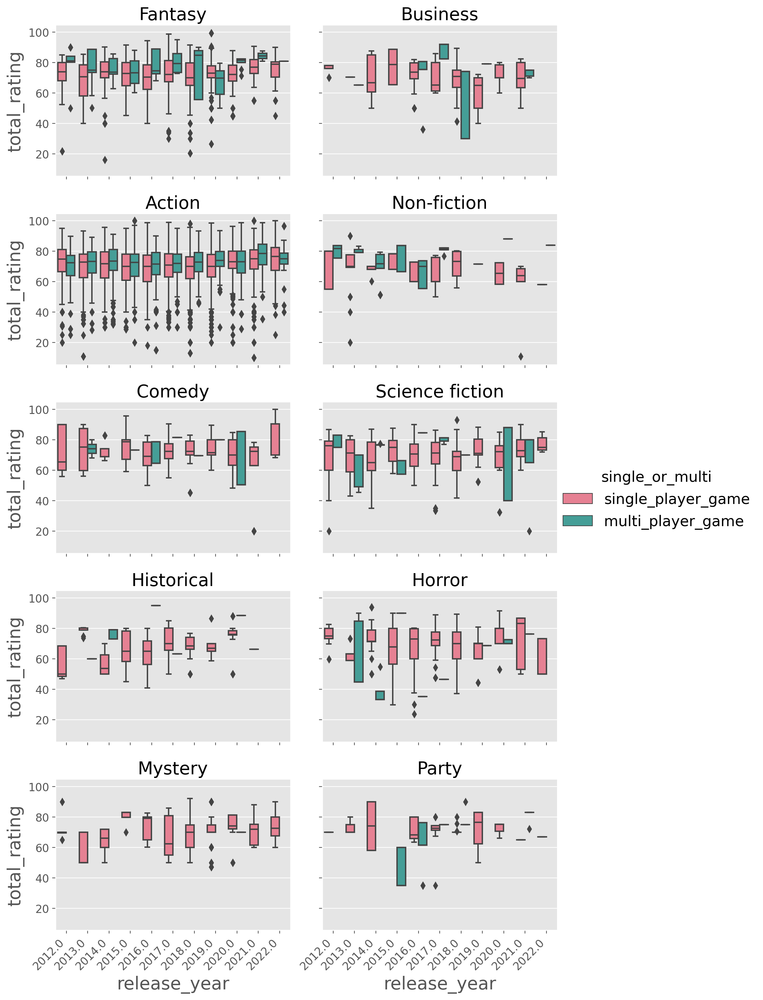

In [375]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'themes_description_clean')

No interesting insights here.

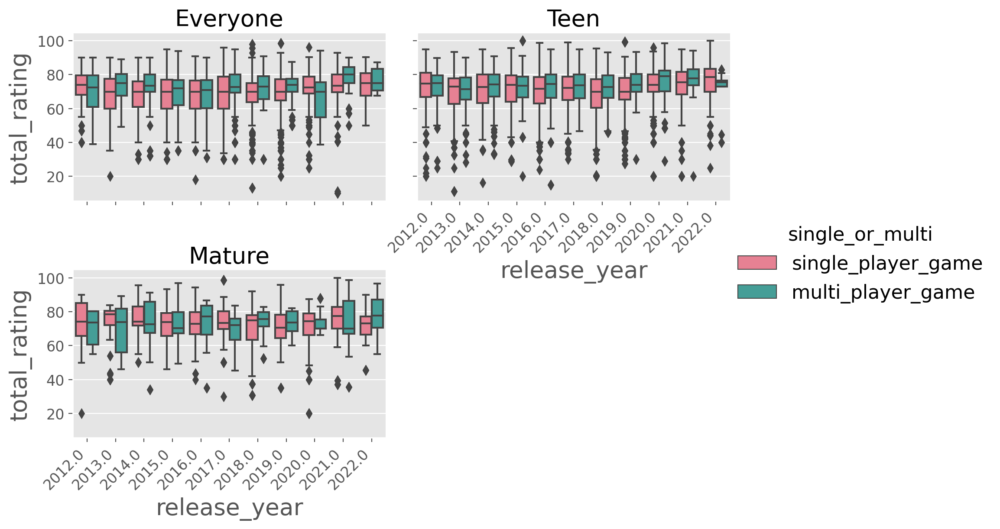

In [376]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'age_group_clean')

For the last 5 years, Median rating for 'Everyone' group appears to be on an increasing trend for both single and multi player games.
Median rating for Teen multi player games dipped in 2018 and is on an upward trend from then onwards.
Median rating for Mature games seems to not follow any trend.

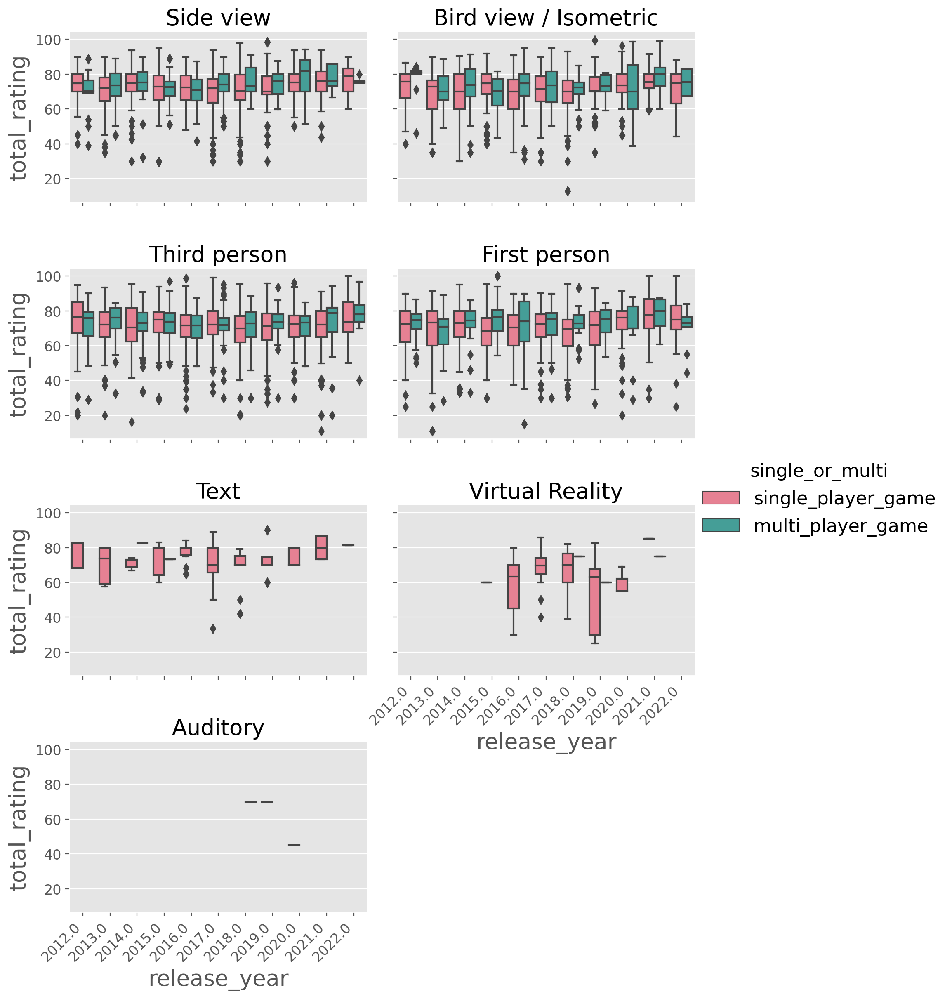

In [377]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'player_perspectives_clean')

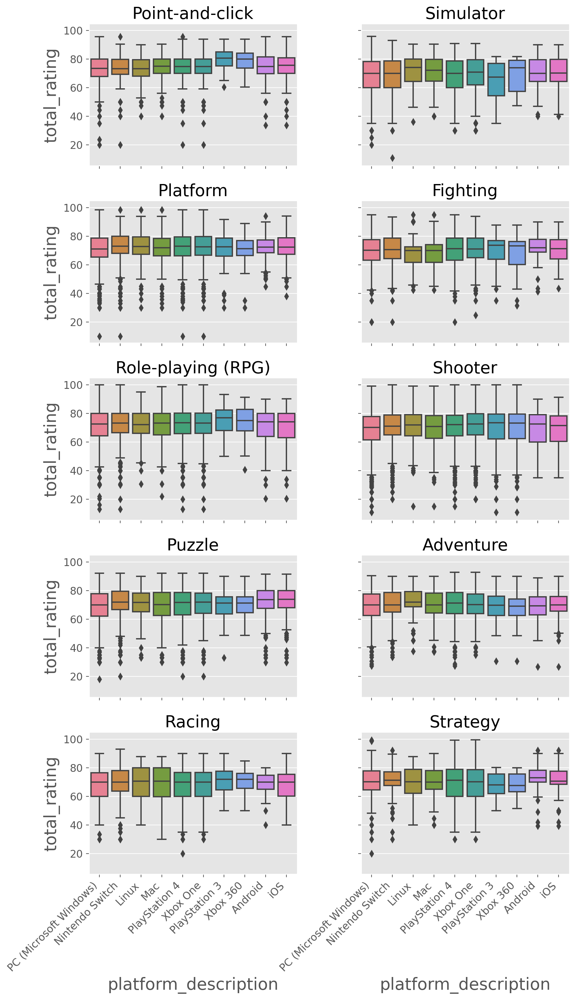

In [381]:
boxplot_for_rating_by_cat(x = 'platform_description', col = 'genres_description_clean')

Highest Median Rating in each genre:

-   Point and Click: PS3. I wasn't expecting this at all.
-   Simulator: Linux followed by Mac.
-   Platform: Nintendo Switch
-   Fighting: PS3 followed by Xbox 360
-   RPG: PS3 followed by Xbox 360
-   Shooter: This one was highly competitive with PS3 and Xbox 360 edging out others
-   Puzzle: Android and iOS
-   Adventure: Linux followed by PS4. Linux has unusually high ratings here but that may be because only great games released for windows are made compatible for Linux and hence we see higher rating.
-   Racing: PS3 and Xbox 360
-   Strategy: Android

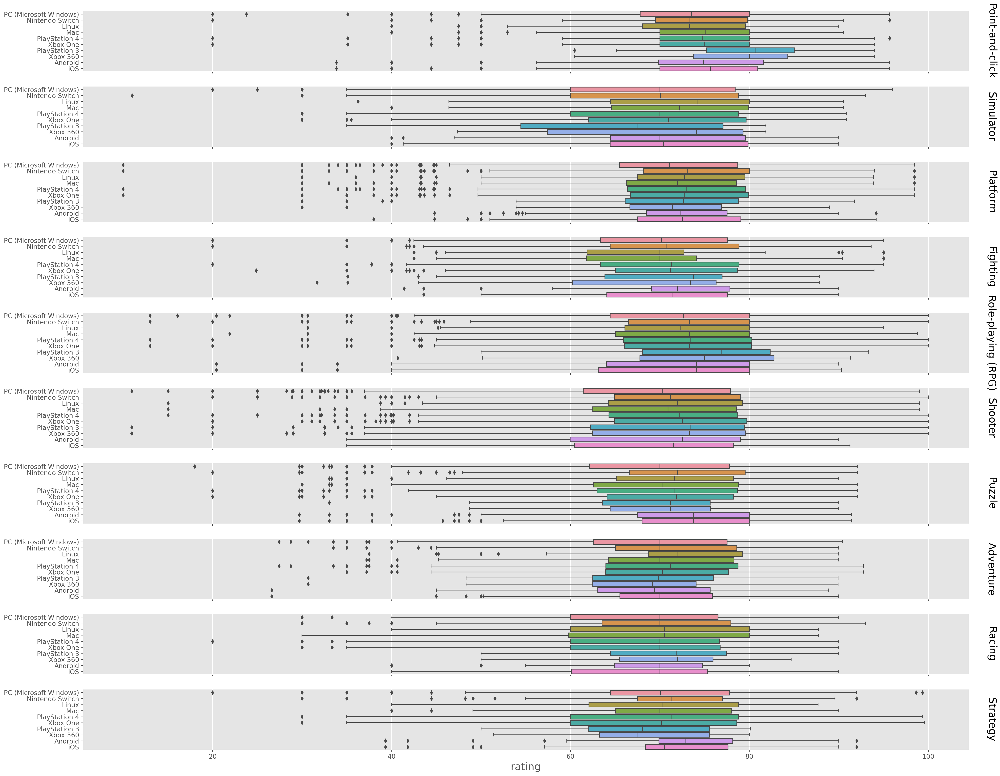

In [379]:
g = sns.catplot(
    data=df_cleaned_exploded,
    x="total_rating", y="platform_description", row="genres_description_clean",
    kind="box", orient="h",
    sharex=True, margin_titles=True,
    height=2, aspect=12,
)
g.set(xlabel="rating", ylabel="")
g.set_titles(row_template="{row_name}")


In [382]:
#fig, ax = plt.subplots()
df_cleaned_exploded_agg = df_cleaned_exploded.groupby(['release_year','platform_description','single_or_multi'])['total_rating'].mean().reset_index()
df_cleaned_exploded_agg.head()

#g = sns.FacetGrid(df_cleaned_exploded_agg, col='single_or_multi', hue='platform_description')
#g = g.map(sns.lineplot, 'release_year', 'total_rating', ci=None).add_legend()

fig = px.line(df_cleaned_exploded_agg, x='release_year', y='total_rating', color='platform_description')
fig.show()
""" sns.relplot(
    data=df_cleaned_exploded_agg, x="release_year", y="total_rating",
    col="single_or_multi", hue="platform_description", style="single_or_multi",
    kind="line"
) """
""" # Create a boxplot
sns.lineplot(x='release_year', y='total_rating', hue='platform_description', col = 'single_or_multi', data=df_cleaned_exploded_agg)

# Labelling
ax.set(title='Comparison of Rating',
       xlabel='', ylabel='Rating')

# Rotate xticks
ax.set_xticklabels(ax.get_xticklabels(), rotation=60)

plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.)
plt.show(); """

,release_year,platform_description,single_or_multi,total_rating
0,2012.0,Android,multi_player_game,73.855764
1,2012.0,Android,single_player_game,74.821497
2,2012.0,Linux,multi_player_game,75.573582
3,2012.0,Linux,single_player_game,75.552725
4,2012.0,Mac,multi_player_game,73.742170


' sns.relplot(\n    data=df_cleaned_exploded_agg, x="release_year", y="total_rating",\n    col="single_or_multi", hue="platform_description", style="single_or_multi",\n    kind="line"\n) '

" # Create a boxplot\nsns.lineplot(x='release_year', y='total_rating', hue='platform_description', col = 'single_or_multi', data=df_cleaned_exploded_agg)\n\n# Labelling\nax.set(title='Comparison of Rating',\n       xlabel='', ylabel='Rating')\n\n# Rotate xticks\nax.set_xticklabels(ax.get_xticklabels(), rotation=60)\n\nplt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.)\nplt.show(); "

In [384]:
""" df_cleaned_exploded_top = df_cleaned_exploded.groupby(['release_year','platform_description','single_or_multi',
                                                       'genres_description_clean','themes_description_clean','age_group_clean',
                                                       'player_perspectives_clean'])['total_rating'].median().reset_index().sort_values(by='total_rating', ascending=False)

df_cleaned_exploded_top.head() """

#'release_year' removed
df_cleaned_exploded_top = df_cleaned_exploded.groupby(['release_year','platform_description','single_or_multi',
                                                       'genres_description_clean','themes_description_clean','age_group_clean',
                                                       'player_perspectives_clean']).agg(
                                                        {'total_rating': ['mean', 'median', 'size']                                                        
                                                        })#.reset_index()#.sort_values(by=['median','size'], ascending = False)
df_cleaned_exploded_top.columns = ['mean_rating','median_rating','group_size']

df_cleaned_exploded_top = df_cleaned_exploded_top.reset_index().sort_values(by=['median_rating','release_year','group_size'], ascending = [False,True,False])

df_cleaned_exploded_top

df_cleaned_exploded_top.to_csv("median_ratings_for_groups.csv", index = False)

" df_cleaned_exploded_top = df_cleaned_exploded.groupby(['release_year','platform_description','single_or_multi',\n                                                       'genres_description_clean','themes_description_clean','age_group_clean',\n                                                       'player_perspectives_clean'])['total_rating'].median().reset_index().sort_values(by='total_rating', ascending=False)\n\ndf_cleaned_exploded_top.head() "

,release_year,platform_description,single_or_multi,genres_description_clean,themes_description_clean,age_group_clean,player_perspectives_clean,mean_rating,median_rating,group_size
7934,2021.0,PC (Microsoft Windows),single_player_game,Role-playing (RPG),Action,Mature,First person,100.0,100.0,1
8066,2021.0,PlayStation 4,single_player_game,Role-playing (RPG),Action,Mature,First person,100.0,100.0,1
8189,2021.0,Xbox One,single_player_game,Role-playing (RPG),Action,Mature,First person,100.0,100.0,1
8313,2022.0,Nintendo Switch,single_player_game,Role-playing (RPG),Comedy,Teen,Third person,100.0,100.0,1
8393,2022.0,PC (Microsoft Windows),single_player_game,Role-playing (RPG),Comedy,Teen,Third person,100.0,100.0,1
...,...,...,...,...,...,...,...,...,...,...
7901,2021.0,PC (Microsoft Windows),single_player_game,Point-and-click,Comedy,Teen,Third person,20.0,20.0,1
7999,2021.0,PlayStation 4,multi_player_game,Racing,Science fiction,Teen,Third person,20.0,20.0,1
8042,2021.0,PlayStation 4,single_player_game,Point-and-click,Comedy,Teen,Third person,20.0,20.0,1
8164,2021.0,Xbox One,single_player_game,Point-and-click,Comedy,Teen,Third person,20.0,20.0,1


Next, let us try to understand relationships between different categorical features with the help of a parallel categories diagram.
Since we have too many groups in each categorical feature, let's simplify it down to top 5 groups to understand what is going on.

In [386]:
# Let's unpack this df based on platforms
#df_cleaned_exploded = df_cleaned.apply(lambda x: x.explode() if x.name == 'platform_description' else x).reset_index()

# Consider top categories. Too many categories will not be useful.
platform_categories = list(df_cleaned_exploded['platform_description'].value_counts().nlargest(5).index)
genres_categories = list(df_cleaned_exploded['genres_description_clean'].value_counts().nlargest(5).index)
themes_categories = list(df_cleaned_exploded['themes_description_clean'].value_counts().nlargest(5).index)
age_categories = list(df_cleaned_exploded['age_group_clean'].value_counts().nlargest(5).index)
player_perspectives_categories = list(df_cleaned_exploded['player_perspectives_clean'].value_counts().nlargest(5).index)

# Filtering the data for only top categories in each column
df_cleaned_exploded_simplified = df_cleaned_exploded[(df_cleaned_exploded['total_rating'] > 0) &
                                          (df_cleaned_exploded['platform_description'].isin(platform_categories)) &
                                          (df_cleaned_exploded['genres_description_clean'].isin(genres_categories)) &
                                          (df_cleaned_exploded['themes_description_clean'].isin(themes_categories)) &
                                          (df_cleaned_exploded['age_group_clean'].isin(age_categories)) &
                                          (df_cleaned_exploded['player_perspectives_clean'].isin(player_perspectives_categories)) &
                                          (df_cleaned_exploded['release_year'] > 2011)]

df_cleaned_exploded_simplified['rating_0_to_5'] = df_cleaned_exploded_simplified['total_rating']/20


df_cleaned_exploded_simplified['rating_cat'] = (
    np.select(
        condlist=[df_cleaned_exploded_simplified['total_rating'] < 60, (df_cleaned_exploded_simplified['total_rating'] >= 60) & (df_cleaned_exploded_simplified['total_rating'] <= 75),
        df_cleaned_exploded_simplified['total_rating'] > 75], 
        choicelist=["bad", "good", "great"], 
        default=""))

df_cleaned_exploded_simplified['rating_cat_code'] = (
    np.select(
        condlist=[df_cleaned_exploded_simplified['total_rating'] < 60, (df_cleaned_exploded_simplified['total_rating'] >= 60) & (df_cleaned_exploded_simplified['total_rating'] <= 75),
        df_cleaned_exploded_simplified['total_rating'] > 75], 
        choicelist=[0, 1, 2], 
        default=3))

df_cleaned_exploded_simplified.head()                                          

,index,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,category_description,single_or_multi,log_hypes,log_follows,log_total_rating_count,platform_description,genres_description,themes_description,age_group,player_perspectives_description,release_year,age_group_clean,genres_description_clean,themes_description_clean,player_perspectives_clean,rating_0_to_5,rating_cat,rating_cat_code
188,1149,0,2016-08-24 04:27:32,2012-03-16,"[4, 5]",Top Gun: Hard Lock,"[6, 9, 12]","[242807, 242808, 242809, 242810, 242...","[19164, 55038, 103298, 103301, 10504...",top-gun-hard-lock,NaN,Top Gun: Hard Lock was released in M...,[1],2022-03-03 11:54:07,"[180767, 180768]","[36099, 36100]","[127984, 127985, 127986]",NaN,"[1, 2]",[48983],75.000000,0.0,The player takes the role of a pilot...,75.000000,0.0,NaN,NaN,NaN,[535],NaN,NaN,NaN,NaN,[14375],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,multi_player_game,NaN,NaN,-inf,PC (Microsoft Windows),"[Fighting, Shooter]",[Action],"[13+, 12+]","[First person, Third person]",2012.0,Teen,Fighting,Action,First person,3.750000,good,1
202,1198,0,2017-05-20 19:16:04,2017-09-29,"[12, 15, 32, 35]",Throne of Lies: Medieval Politics,[6],[131989],"[18918, 19150, 19404, 20331, 22387, ...",throne-of-lies-medieval-politics,NaN,The 3D online multiplayer game of so...,"[17, 21, 23, 27, 31, 40, 43]",2021-10-01 09:11:58,"[42558, 42559, 164003, 164004, 16400...",[14427],[87844],[1145],"[2, 3, 5]",NaN,80.000000,1.0,NaN,80.000000,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,[12730],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,multi_player_game,NaN,0.000000,0.000000,PC (Microsoft Windows),"[Role-playing (RPG), Strategy, Indie...","[Fantasy, Survival, Stealth, Comedy,...",[10+],"[Third person, Bird view / Isometric...",2017.0,Everyone,Role-playing (RPG),Fantasy,Third person,4.000000,great,2
218,1339,0,2015-06-05 08:08:04,2013-05-15,"[5, 32, 33]",Thunder Wolves,"[6, 9, 12]","[35452, 35453, 35454, 35455]","[7350, 8422, 27419, 28751, 43367, 56...",thunder-wolves,NaN,Thunder Wolves is a third-person sho...,[1],2022-02-24 01:56:31,"[26507, 26508]","[7442, 7443]","[26273, 26274]",NaN,"[1, 2]",NaN,80.000000,1.0,"When this ""wolf pack"" strikes, you h...",78.000000,3.0,NaN,NaN,NaN,NaN,1.0,NaN,76.0,2.0,[3095],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,multi_player_game,NaN,0.000000,0.477121,PC (Microsoft Windows),"[Shooter, Indie, Arcade]",[Action],"[15+, 16+]","[First person, Third person]",2013.0,Teen,Shooter,Action,First person,3.900000,great,2
282,1733,0,2014-06-10 21:23:55,2017-06-23,"[5, 31, 32]",Get Even,"[6, 48, 49]","[71542, 71543, 71544]","[11646, 18290, 25300, 25843, 33153, ...",get-even,NaN,"""Take a deep breath..."" Try to remem...","[1, 18, 19, 20, 21]",2022-08-23 23:50:28,"[18460, 18461, 47053, 79198, 79199, ...","[22214, 87067]","[17400, 37031]",[6],[1],"[8675, 9615, 12056, 12792, 13740, 13...",67.909259,21.0,Black - an ice-cold mercenary and hi...,70.854629,33.0,NaN,NaN,10.0,NaN,39.0,NaN,73.8,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,main_game,single_player_game,1.0,1.591065,1.518514,PC (Microsoft Windows),"[Shooter, Adventure, Indie]","[Action, Science fiction, Horror, Th...","[16+, 15+]",[First person],2017.0,Mature,Shooter,Action,First person,3.542731,good,1
283,1733,0,2014-06-10 21:23:55,2017-06-23,"[5, 31, 32]",Get Even,"[6, 48, 49]","[71542, 71543, 71544]","[11646, 18290, 25300, 25843, 33153, ...",get-even,NaN,"""Take a deep breath..."" Try to remem...","[1, 18, 19, 20, 21]",2022-08-23 23:50:28,"[18460, 18461, 47053, 79198, 79199, ...","[22214, 87067]","[17400, 37031]",[6],[1],"[8675, 9615, 12056, 12792, 13740, 13...

In [390]:
fig = px.parallel_categories(df_cleaned_exploded_simplified[df_cleaned_exploded_simplified.total_rating_count > 0],
                             dimensions=[  
                                          'age_group_clean','player_perspectives_clean', 'rating_cat'])
                             #color="total_rating", color_continuous_scale=px.colors.sequential.Inferno)                
                             #labels={'sex':'Payer sex', 'smoker':'Smokers at the table', 'day':'Day of week'})
fig.show()

In [392]:
# Create dimensions
platform_dim = go.parcats.Dimension(
    values=df_cleaned_exploded_simplified.platform_description, label="platform"
    #categoryorder='category ascending', label="platform"
)

age_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.age_group_clean, label="age limit")

rating_dim = go.parcats.Dimension(
    values=df_cleaned_exploded_simplified.rating_cat_code, label="rating", categoryarray=[0,1,2],
    ticktext=['bad', 'good', 'great']
)

genres_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.genres_description_clean, label="genre")

themes_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.themes_description_clean, label="theme")

perspectives_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.player_perspectives_clean, label="perspective")

# Create parcats trace
color = df_cleaned_exploded_simplified.rating_cat_code;
colorscale = "BuGn";

fig = go.Figure(data = [go.Parcats(dimensions=[age_dim, platform_dim, themes_dim, genres_dim, perspectives_dim, rating_dim],#platform_dim, themes_dim, genres_dim, perspectives_dim
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

fig.show()

This is a lot but let's unpack this slowly by taking a look at the probabilities.

If we hover over each group, we can see three probabilities here:

1) P(Color and age limit group). Example: If we highlight white block (bad) in age limit category, we would see P(bad and Teen) = 0.072. It means 7.2% of the games are bad and belong to teen age group.
   If we add up these probabilities for all combinations under age limit category (bad and teen, good and teen, great and teen, bad and Everyone, good and Everyone, great and Everyone, ....) they would all sum up to 1.

2) P(age limit group | Color). Example: If we highlight white block (bad) in age limit category, we would see P(Teen | bad) = 0.539. Given that a game is bad, the chance that it is from Teen group is 53.9%.
   If we add up P(Teen | bad), P(Everyone | bad) and P(Mature | bad), it sums up to 1 (0.539, 0.387, 0.075).  

3) P(Color | age limit group). If we highlight white block (bad) in age limit category, we would see P(bad | Teen) = 0.131. It means given that a game is bad, the chance that it belongs to Teen group is 13.1%.
    If we add up P(bad | Teen), P(good | Teen), P(great | Teen), they all sum up to 1.

The first two probabilities are affected by the proportion of the observations in the dataset while the third is not. The third is the one we are most interested in.
Let us see what groups are contributing most to the great games regardless of the proportion of games.

These 2 tables below show group within each category that has most great or most bad games.

Here are the groups with highest % of great games:


Group |% of games that are great given a category group
-----|-----
Mature|48% (only 36% given 'Everyone' group). In other words, in age limit category, 48% of the games will be great given they belong to Mature group (41.7% from Teen, 36.4% from Everyone) and so on.
Nintendo Switch|42% (This only edges out Xbox One and PS4 by 1% and PC Windows and Mac by 3%)
Fantasy|47% (while only 27% of great games given Horror)
RPG|45% (only 36% from Fighting and Puzzle)
Text View|48% (~39% from Bird, First person and Third person views)

Here are groups with highest % of bad games from each category:

Group |% of games that are bad given a category group
-----|-----
Everyone|14% (all 3 groups have roughly the same percentage)
PC Windows|15% (again all of the 5 groups have roughly same percentage)
Horror|26% (while Fantasy and Action have only 11 and 13% respectively)
Shooter|16% (Platform group has the least (12%) percentage of bad games)
First Person|18% (Text games have only 9%)

It looks like bad games proportion is very less among groups while great games come from the above mentioned groups above 40% of the time.
The bad, good and great buckets we created have different proportion of games that fall into each.
This means that there are not many games (only 13% of all games fall under bad group while 46% and 40% fall under good and great groups) with less than rating 60 and we should consider defining bad category at higher than 60 to make more games fall under that category and see how percentage changes. 

# 6. Brief Conclusion of the EDA

In short, this dataset clearly showed how competetive the Google Play Store is. More than half of the apps had close to 0 ratings and installs. 

Even though there were more than 50 categories, only top 8 were explored which accounted to more than half of all apps. Among the top 8, `Tools` category was a clear winner in terms of install and rating count. 

Majority of the paid apps cost around a dollar however there were outliers as huge as 400 dollars. 
Coming to paid apps, most expensive categories were Food & Drink and Business. 

In 4th and 5th parts of the exploration, the dataset was looked at from different angles. Specifically, the relationships between rating and rating count, rating and install count, rating and maintenance were explored. 

For better insight, apps with no ratings and installs were exlcuded. This showed that most apps had a rating of ~4.5 and most highly-rated apps were in Music.